# Run 35 IV/dIdV Sweep 1 

## Overview

Author: Maggie Reed
Last Updated: 11/28/2023

----
 
This notebook contains the analysis for IV sweeps taken 11/13/2023 (IV sweep 1 of 2) on the CPDv21AlO3, IrPtV2TESSmall, IrPtV2TESBig devices. More information on this run, its purpose, and other summaries can be found in the Run 35 shared Pyle google drive Analysis/Operation folder. 

NOTE: this data was taken with a lower signal generator than appropriate. Another IV sweep with a higher signal generator setting was taken later in the run. 


----
Data: November 13th 2023

Time into run: Day1

Beginning IV/dIdV sweeps (IV sweep 1 of 2):

iv_didv_D20231113_T151236: CPDv21AlO3

iv_didv_D20231113_T175430: IrPtV2TESSmall

iv_didv_I2_D20231113_T220059: IrPtV2TESBig

# Setup 

In [2]:
#basic imports
import pandas as pd
import time as tm
from glob import glob
import numpy as np
import scipy.constants as constants
#plotting
import matplotlib.pyplot as plt
import matplotlib as mpl
mpl.rcParams['figure.figsize'] = [10, 6.5]

#processing and analysis imports
from pytesdaq.processing import IVSweepProcessing, IVanalysis
from pytesdaq.processing import _iv_didv_tools_plotting as plot
from pytesdaq.io.hdf5 import H5Reader
h5read = H5Reader() 

import qetpy
import pickle

In [3]:
# channels
channels = ['CPDv21Al2O3','IrPtTESSmallV2','IrPtTESBigV2']

# path 
save_path = '/home/maggie_reed/processing/run35/didv/'
#savename = ['darkm_sweeps_ch_1pc','darkm_sweeps_ch_25pcLeft','darkm_sweeps_ch_025pcRight']

sweep_data_path = ['/sdata2/runs/run35/raw/iv_didv_I2_D20231113_T151236/', #CPDv21AlO3
             '/sdata2/runs/run35/raw/iv_didv_I2_D20231113_T175430/', #IrPtV2TESSmall
             '/sdata2/runs/run35/raw/iv_didv_I2_D20231113_T220059/'] #IrPtV2TESBig

basedir = ['/home/maggie_reed/analysis/run35/didv/figs/CPDv21AlO3/sweep1/',
           '/home/maggie_reed/analysis/run35/didv/figs/IrPtV2TESSmall/sweep1/',
           '/home/maggie_reed/analysis/run35/didv/figs/IrPtV2TESBig/sweep1/']
fs = 1.25e6

## Processing Sweep

In [12]:
for i in range(len(channels)):
    nfiles = len(glob(f'{sweep_data_path[i]}*'))
    print(f'There are {nfiles} files in {channels[i]}')

There are 45 files in CPDv21Al2O3
There are 51 files in IrPtTESSmallV2
There are 53 files in IrPtTESBigV2


In [13]:
'''
for i in range(len(channels)):
    start_time = tm.time()
    print(f'Starting processing of {channels[i]}')
    # instantiate
    iv_didv = IVSweepProcessing(sweep_data_path[i])
    iv_didv.describe()

    # process
    df = iv_didv.process(channels[i], 
                         lgc_save=True, 
                         save_path=save_path,
                         lgc_output=True, 
                         ncores=8) 
    
    end_time = tm.time()
    print(f'IV sweep took {(end_time - start_time)/60: .3f} min to process')
#''';

Starting processing of CPDv21Al2O3
IV/dIdV Sweep: iv_didv_I2_D20231113_T151236
 
CPDv21Al2O3:
 -IV: 22 bias points
 -dIdV: 22 bias points
INFO: IV processing will be split between 8 core(s)!
INFO IV node #1: starting processing series I2_D20231113_T151300INFO IV node #2: starting processing series I2_D20231113_T152433INFO IV node #3: starting processing series I2_D20231113_T153603INFO IV node #5: starting processing series I2_D20231113_T155906INFO IV node #6: starting processing series I2_D20231113_T161039INFO IV node #7: starting processing series I2_D20231113_T162209INFO IV node #4: starting processing series I2_D20231113_T154736INFO IV node #8: starting processing series I2_D20231113_T162950







INFO IV node #4: starting processing series I2_D20231113_T155125
INFO IV node #2: starting processing series I2_D20231113_T152822
INFO IV node #5: starting processing series I2_D20231113_T160258
INFO IV node #3: starting processing series I2_D20231113_T153955
INFO IV node #2: starting pro

## Loading

In [4]:
series_name = 'iv_didv_I2_D20231113_T151236/'
save_name = 'IV_dIdV_processing_D20231128_T101500'
df_alo3 = pd.read_hdf(save_path + series_name + save_name + '.hdf5',
                   key=channels[0])

In [5]:
series_name = 'iv_didv_I2_D20231113_T175430/'
save_name = 'IV_dIdV_processing_D20231128_T104041'
df_irptsmall = pd.read_hdf(save_path + series_name + save_name + '.hdf5',
                   key=channels[1])

In [6]:
series_name = 'iv_didv_I2_D20231113_T220059/'
save_name = 'IV_dIdV_processing_D20231128_T110925'
df_irptbig = pd.read_hdf(save_path + series_name + save_name + '.hdf5',
                   key=channels[2])

## IV object

In [20]:
for ichan,chan in enumerate(channels):
    if ichan == 0:
        
        # Fit data
        IVobj_alo3 = IVanalysis(
            df_alo3, 
            nnorm=5, # number of points in normal region
            nsc=6, # number of points in superconducting region
            channels=chan,
            lgcremove_badseries = True,
            figsavepath = basedir[ichan]
        )
        '''
    if ichan == 1:
        
        # Fit data
        IVobj_irptsmall = IVanalysis(
            df_irptsmall, 
            nnorm=4, # number of points in normal region
            nsc=5, # number of points in superconducting region
            channels=chan,
            lgcremove_badseries = True,
            figsavepath = basedir[ichan]
        )
    if ichan == 2:
        
        # Fit data
        IVobj_irptbig = IVanalysis(
            df_irptbig, 
            nnorm=4, # number of points in normal region
            nsc=5, # number of points in superconducting region
            channels=chan,
            lgcremove_badseries = True,
            figsavepath = basedir[ichan]
        )
''';

In [19]:
df_alo3.qetbias*= -1 
#df_irptsmall.qetbias*= -1 
#df_irptbig.qetbias*= -1 

# IV curves

## Alo3

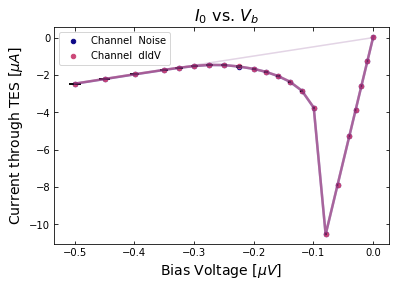

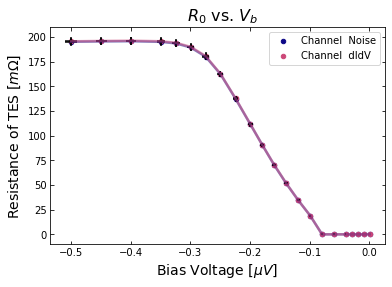

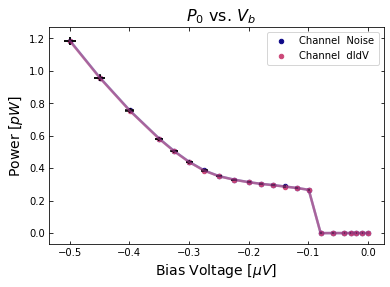

In [21]:
IVobj_alo3.rshunt_err = 0.1e-3
IVobj_alo3.analyze_sweep(lgcplot=True, lgcsave=False)

## IrPt small

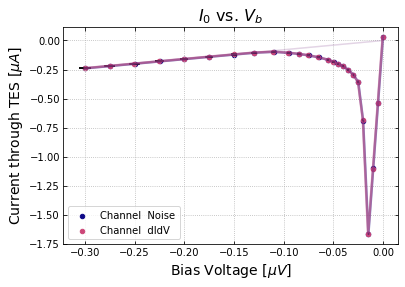

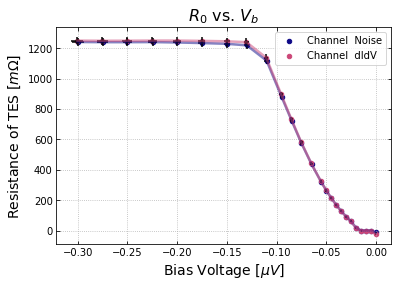

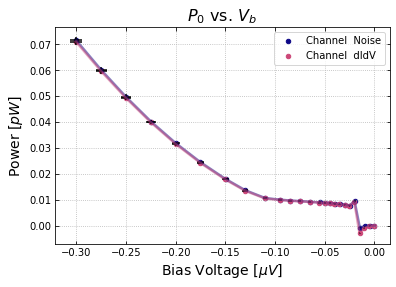

In [35]:
IVobj_irptsmall.rshunt_err = 0.1e-3
IVobj_irptsmall.analyze_sweep(lgcplot=True, lgcsave=False)

## IrPt Big

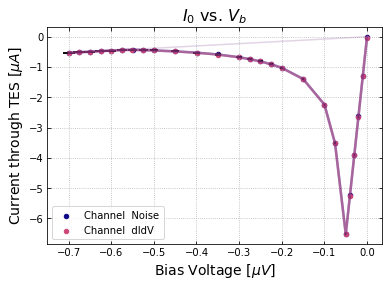

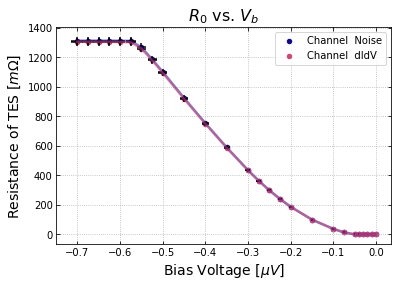

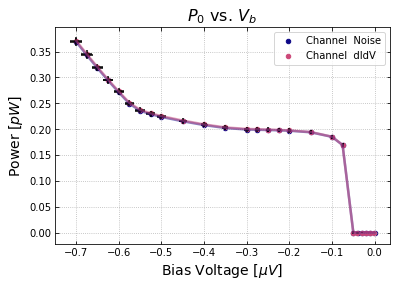

In [36]:
IVobj_irptbig.rshunt_err = 0.1e-3
IVobj_irptbig.analyze_sweep(lgcplot=True, lgcsave=False)

# Fit Rload and Rn

## Alo3

In [23]:
IVobj_alo3.fit_rload_rn(lgcplot=False)

## Small

In [38]:
IVobj_irptsmall.fit_rload_rn(lgcplot=False)

## Big

In [39]:
IVobj_irptbig.fit_rload_rn(lgcplot=False)

# Fit Transition

## Alo3

In [40]:
'''
IVobj_alo3 = IVobj_1pc.df.iloc[42]['didvobj']
IV_1pc_bp_values = IVobj_1pc.df.iloc[42]
savename = '1Pc' + f"{IV_1pc_bp_values['qetbias'] * 1e6:.1f}"
IV_obj_1pc_bp.plot_zoomed_in_trace(saveplot=False)
IV_obj_1pc_bp.plot_re_im_didv(saveplot=False)
#''';

In [24]:
IVobj_alo3.fit_tran_didv(lgcplot=False, lp_cutoff=20e3, zoomfactor=0.05)


27
qetbias: -60.0 r0: 189.9 i0: -1.5 ptes: 0.4 tauplus: 1.2 tauminus: 596.4 3pole tauplus: 1.3 3pole tauminus: 219.6 3pole tau3: 1076.1


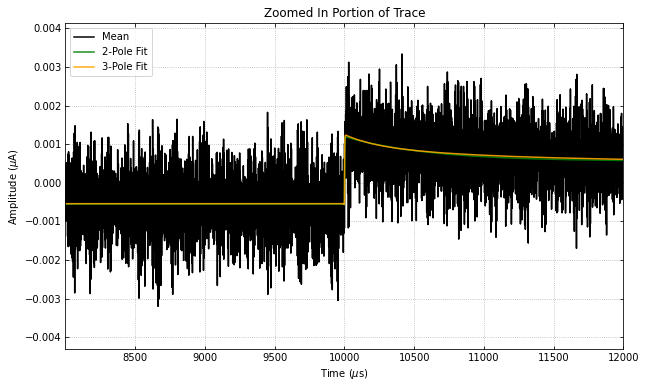

28
qetbias: -55.0 r0: 180.6 i0: -1.5 ptes: 0.4 tauplus: 1.2 tauminus: 432.3 3pole tauplus: 1.3 3pole tauminus: 196.0 3pole tau3: 920.9


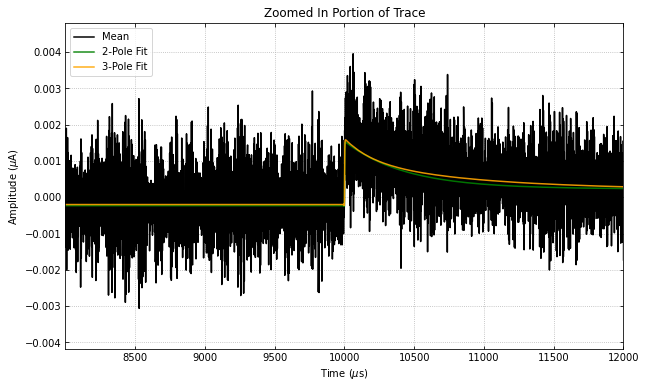

29
qetbias: -50.0 r0: 162.5 i0: -1.5 ptes: 0.3 tauplus: 1.1 tauminus: 347.4 3pole tauplus: 1.2 3pole tauminus: 411.4 3pole tau3: 451.3


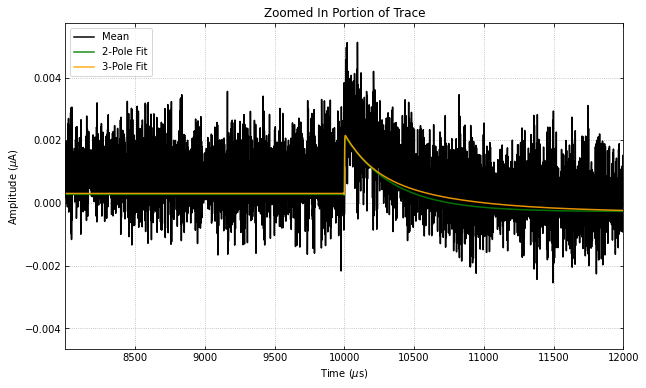

30
qetbias: -45.0 r0: 137.7 i0: -1.5 ptes: 0.3 tauplus: 2.3 tauminus: 237.3 3pole tauplus: 2.5 3pole tauminus: 164.3 3pole tau3: 764.0


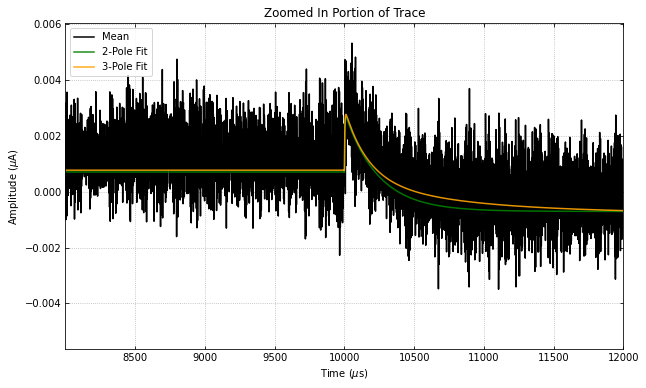

31
qetbias: -40.0 r0: 111.7 i0: -1.7 ptes: 0.3 tauplus: 2.3 tauminus: 219.2 3pole tauplus: 2.4 3pole tauminus: 176.6 3pole tau3: 1073.8


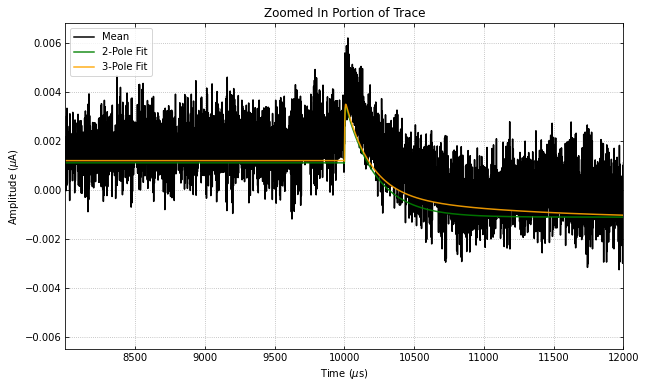

32
qetbias: -36.0 r0: 90.5 i0: -1.8 ptes: 0.3 tauplus: 3.4 tauminus: 202.3 3pole tauplus: 4.0 3pole tauminus: 39.0 3pole tau3: 240.5


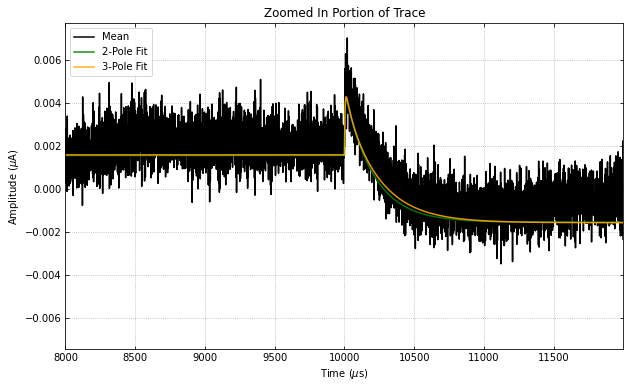

33
qetbias: -32.0 r0: 70.6 i0: -2.0 ptes: 0.3 tauplus: 3.5 tauminus: 201.2 3pole tauplus: 3.5 3pole tauminus: 187.1 3pole tau3: 2400.9


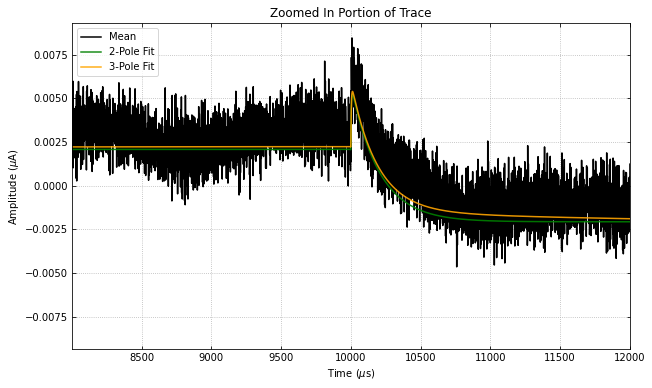

34
qetbias: -28.0 r0: 51.9 i0: -2.3 ptes: 0.3 tauplus: 4.7 tauminus: 192.7 3pole tauplus: 4.9 3pole tauminus: 129.5 3pole tau3: 330.7


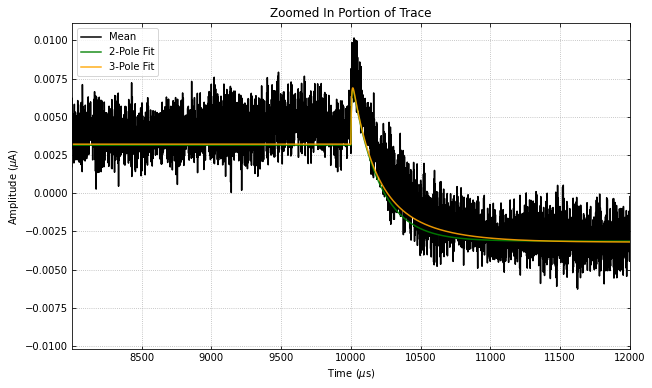

35
qetbias: -24.0 r0: 34.5 i0: -2.8 ptes: 0.3 tauplus: 6.5 tauminus: 238.5 3pole tauplus: 6.9 3pole tauminus: 154.4 3pole tau3: 449.6


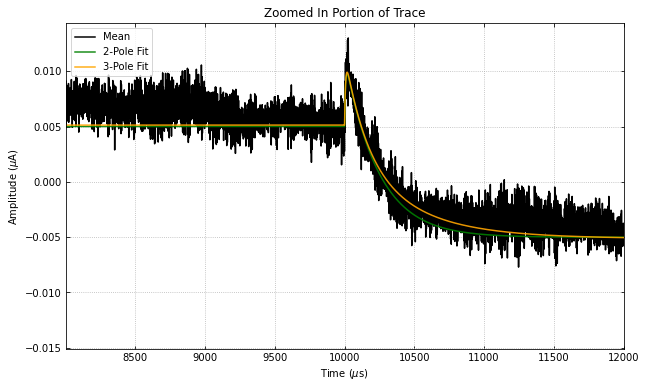

36
qetbias: -20.0 r0: 19.0 i0: -3.7 ptes: 0.3 tauplus: 11.0 tauminus: 302.3 3pole tauplus: 11.7 3pole tauminus: 205.6 3pole tau3: 931.2


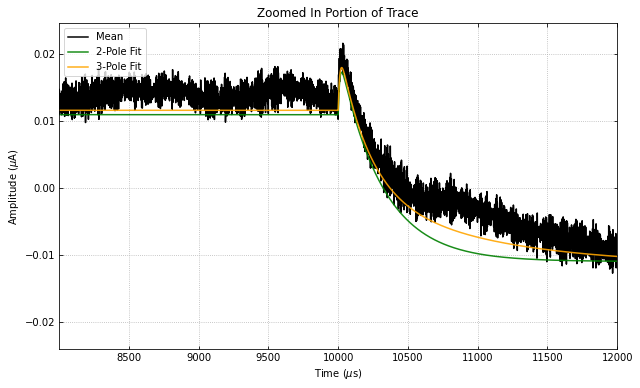

37
qetbias: -16.0 r0: -0.0 i0: -10.5 ptes: -0.0 tauplus: 0.1 tauminus: 50.0 3pole tauplus: 0.0 3pole tauminus: 0.0 3pole tau3: 50.0


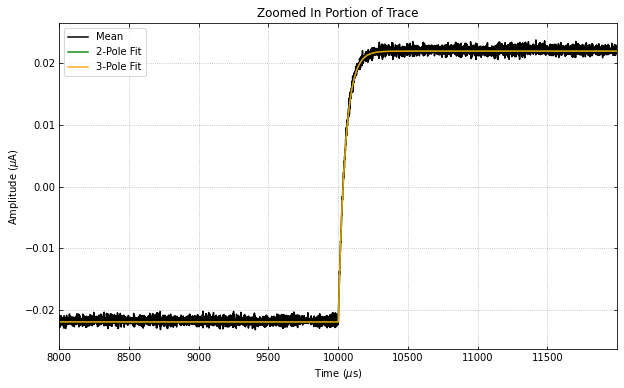

In [42]:
#'''
for index, row in IVobj_alo3.df[IVobj_alo3.didvinds].iloc[IVobj_alo3.traninds].iterrows():
    print(index)
    print(
        f"qetbias: {row['qetbias'] * 1e6:.1f}",
        f"r0: {row['r0'] * 1e3:.1f}",
        f"i0: {row['i0'] * 1e6:.1f}",
        f"ptes: {row['ptes'] * 1e12:.1f}",
        f"tauplus: {row['didvobj'].fitresult(2)['falltimes'][0] * 1e6:.1f}",
        f"tauminus: {row['didvobj'].fitresult(2)['falltimes'][1] * 1e6:.1f}",
        f"3pole tauplus: {row['didvobj'].fitresult(3)['falltimes'][0] * 1e6:.1f}",
        f"3pole tauminus: {row['didvobj'].fitresult(3)['falltimes'][1] * 1e6:.1f}",
        f"3pole tau3: {row['didvobj'].fitresult(3)['falltimes'][2] * 1e6:.1f}",
    )
    savename = 'sap' + f"{row['qetbias'] * 1e6:.1f}"
    row['didvobj_p'].plot_zoomed_in_trace(
        zoomfactor=0.2, saveplot=False, savepath=save_path, savename=savename,
 )
    #''';

## Small

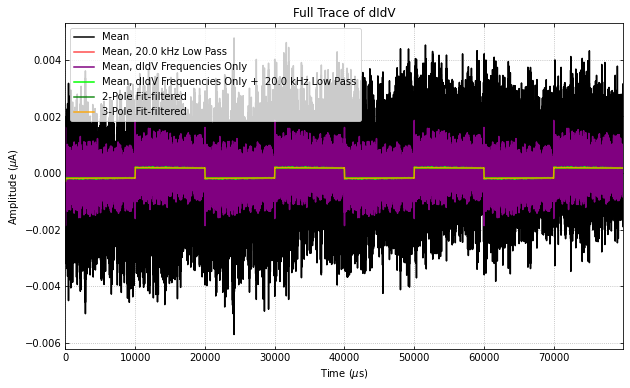

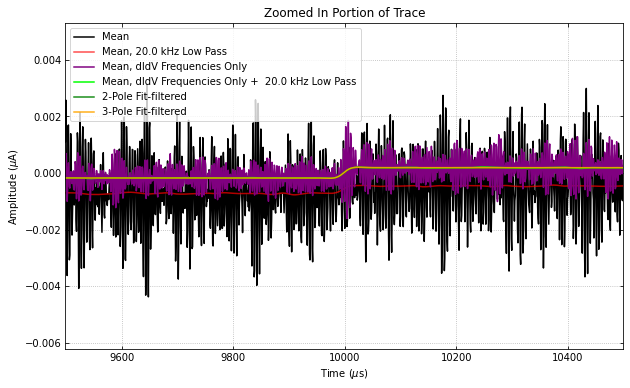

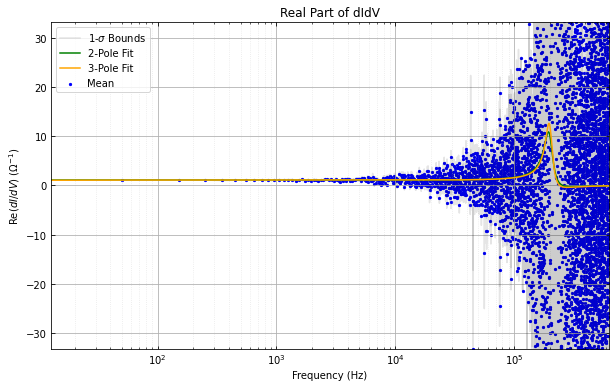

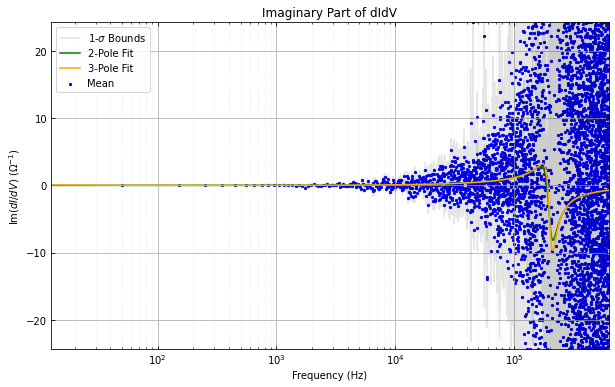

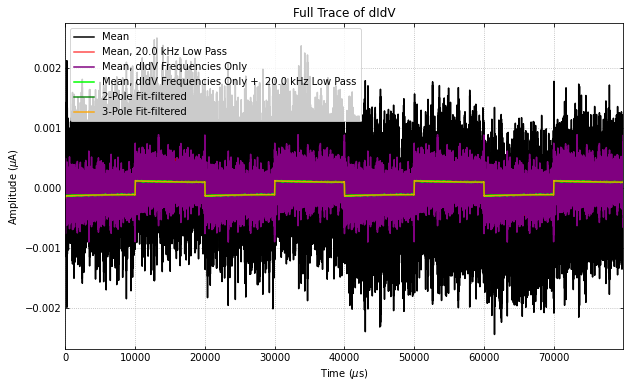

...

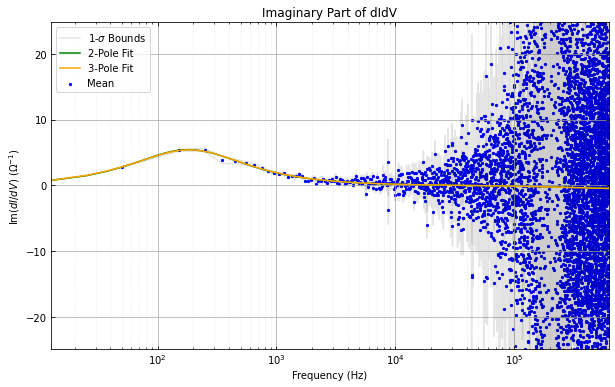

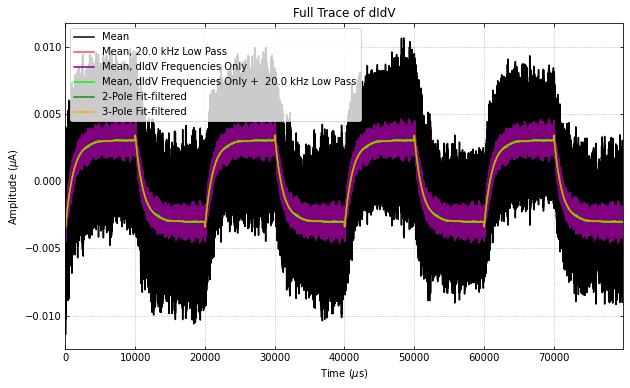

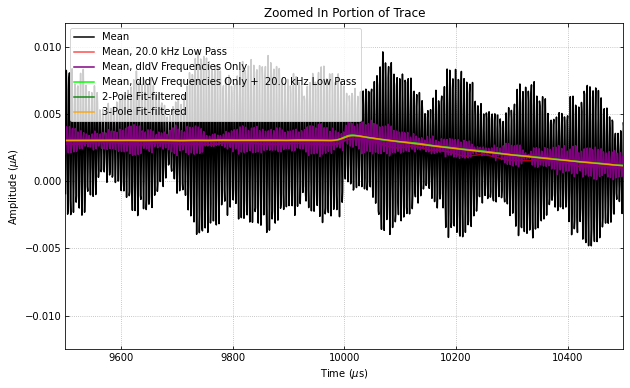

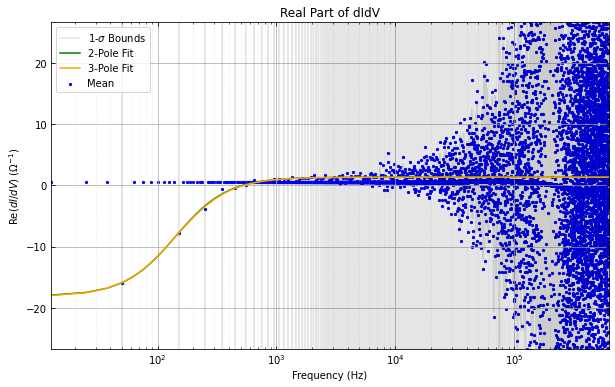

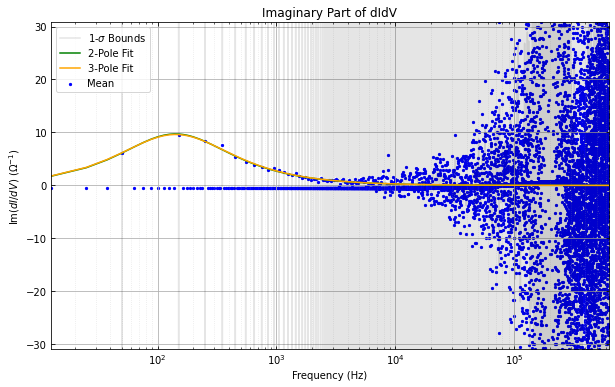

In [43]:
IVobj_irptsmall.fit_tran_didv(lgcplot=True, lp_cutoff=20e3, zoomfactor=0.05)

32
qetbias: -12.0 r0: 905.5 i0: -0.1 ptes: 0.0 tauplus: 0.6 tauminus: 903.6 3pole tauplus: 0.6 3pole tauminus: 20.6 3pole tau3: 928.7


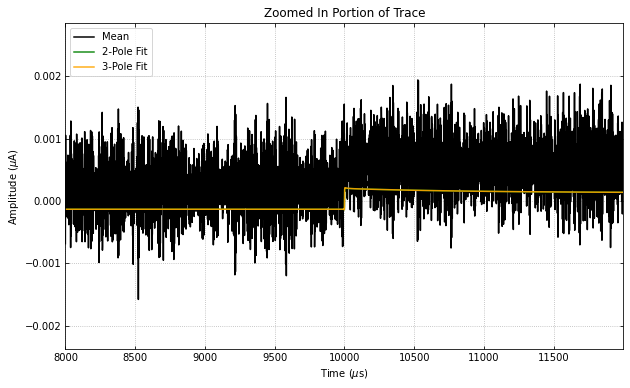

33
qetbias: -10.0 r0: 863.2 i0: -0.1 ptes: 0.0 tauplus: 0.4 tauminus: 825.5 3pole tauplus: 0.4 3pole tauminus: 533.6 3pole tau3: 1748.9


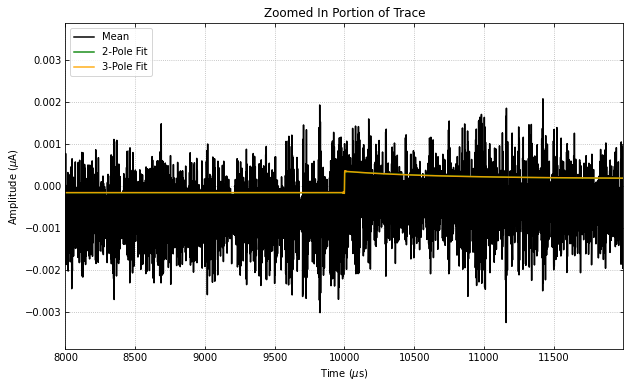

34
qetbias: -8.0 r0: 717.2 i0: -0.1 ptes: 0.0 tauplus: 0.5 tauminus: 495.1 3pole tauplus: 0.6 3pole tauminus: 260.0 3pole tau3: 1286.0


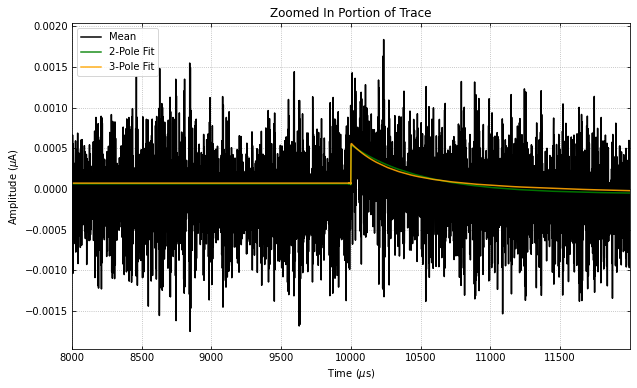

35
qetbias: -7.0 r0: 581.8 i0: -0.1 ptes: 0.0 tauplus: 0.6 tauminus: 242.8 3pole tauplus: 0.7 3pole tauminus: 127.9 3pole tau3: 789.3


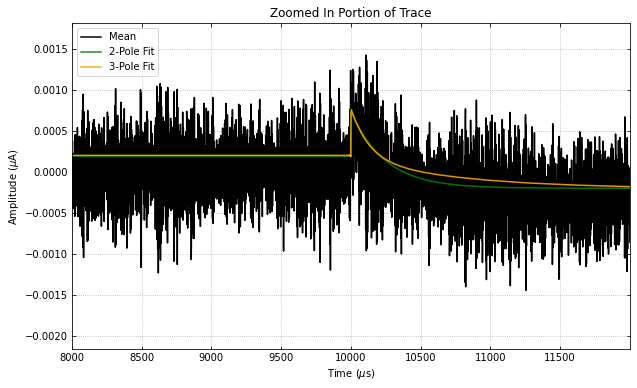

36
qetbias: -6.0 r0: 419.1 i0: -0.1 ptes: 0.0 tauplus: 0.9 tauminus: 139.0 3pole tauplus: 1.2 3pole tauminus: 96.1 3pole tau3: 690.4


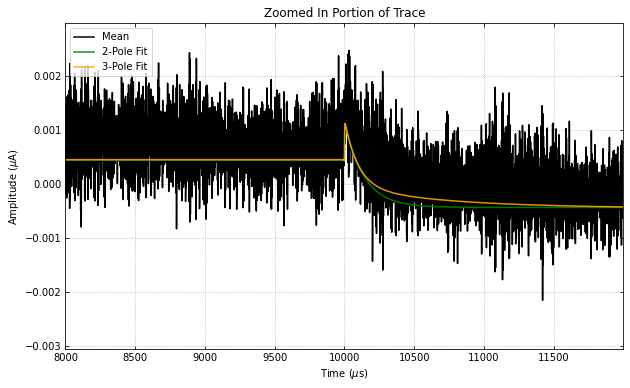

37
qetbias: -5.0 r0: 278.3 i0: -0.1 ptes: 0.0 tauplus: 0.8 tauminus: 107.6 3pole tauplus: 0.9 3pole tauminus: 79.4 3pole tau3: 540.5


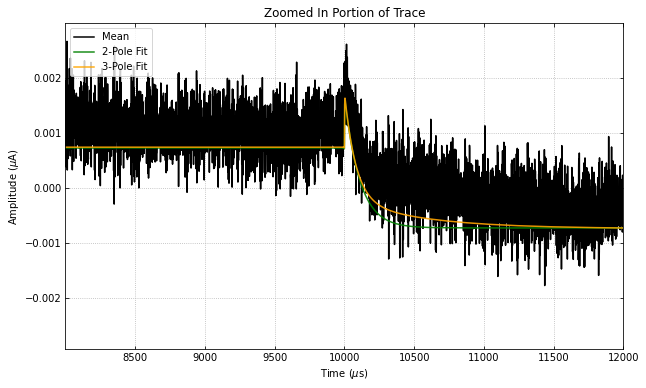

38
qetbias: -4.5 r0: 218.0 i0: -0.1 ptes: 0.0 tauplus: 1.3 tauminus: 105.7 3pole tauplus: 1.5 3pole tauminus: 79.4 3pole tau3: 420.2


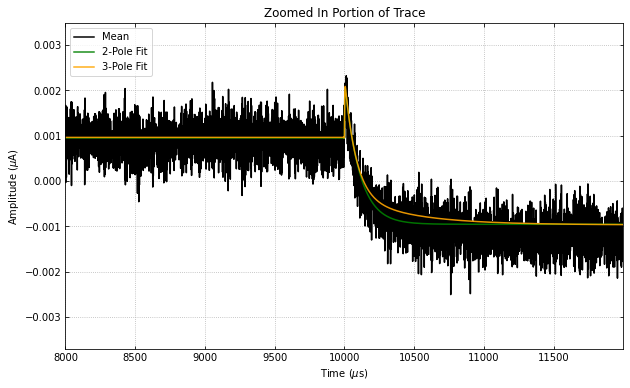

39
qetbias: -4.2 r0: 180.1 i0: -0.1 ptes: 0.0 tauplus: 2.1 tauminus: 99.4 3pole tauplus: 2.3 3pole tauminus: 79.9 3pole tau3: 523.1


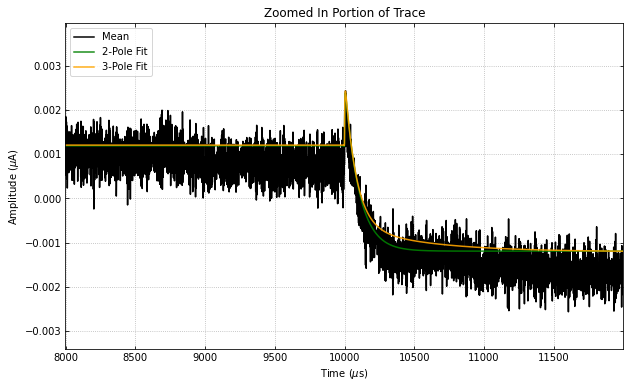

40
qetbias: -3.9 r0: 145.5 i0: -0.1 ptes: 0.0 tauplus: 1.9 tauminus: 102.0 3pole tauplus: 2.2 3pole tauminus: 77.0 3pole tau3: 430.9


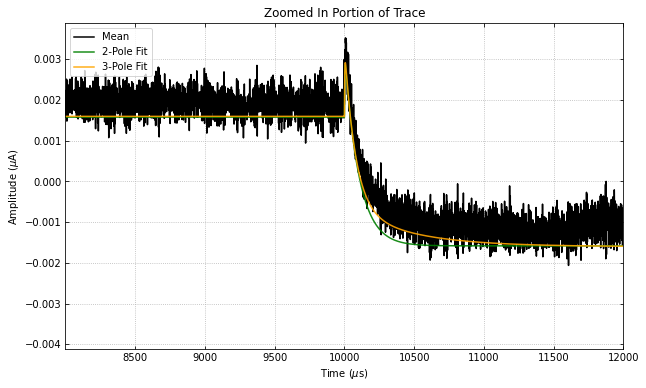

41
qetbias: -3.6 r0: 121.8 i0: -0.1 ptes: 0.0 tauplus: 2.4 tauminus: 102.7 3pole tauplus: 2.7 3pole tauminus: 80.5 3pole tau3: 537.3


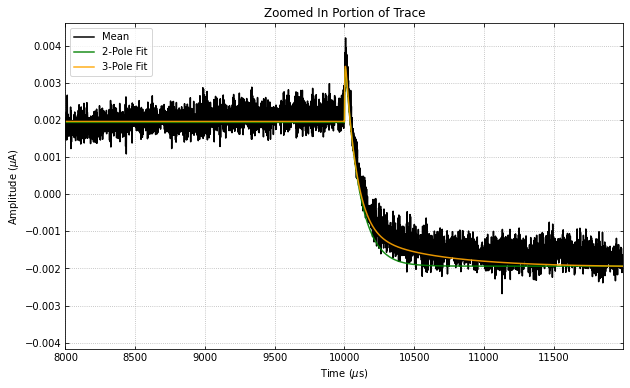

42
qetbias: -3.3 r0: 92.0 i0: -0.2 ptes: 0.0 tauplus: 3.1 tauminus: 104.8 3pole tauplus: 3.7 3pole tauminus: 78.1 3pole tau3: 424.6


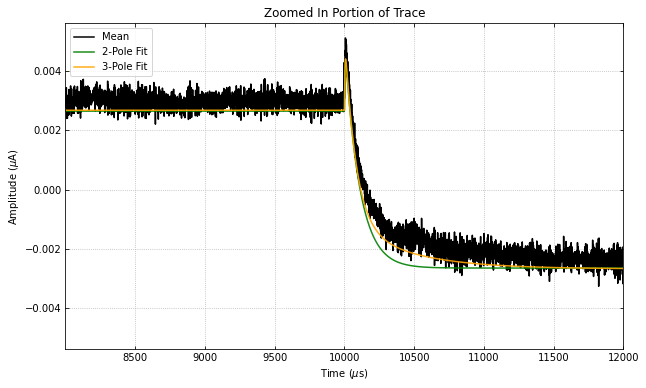

43
qetbias: -3.0 r0: 65.8 i0: -0.2 ptes: 0.0 tauplus: 4.3 tauminus: 112.0 3pole tauplus: 5.2 3pole tauminus: 79.6 3pole tau3: 445.9


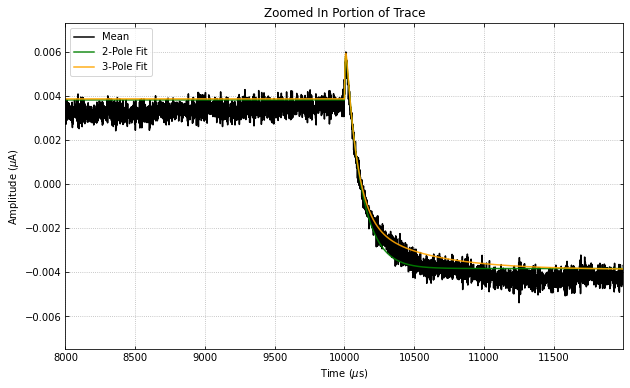

44
qetbias: -2.6 r0: 36.8 i0: -0.3 ptes: 0.0 tauplus: 5.9 tauminus: 137.2 3pole tauplus: 7.1 3pole tauminus: 98.9 3pole tau3: 574.0


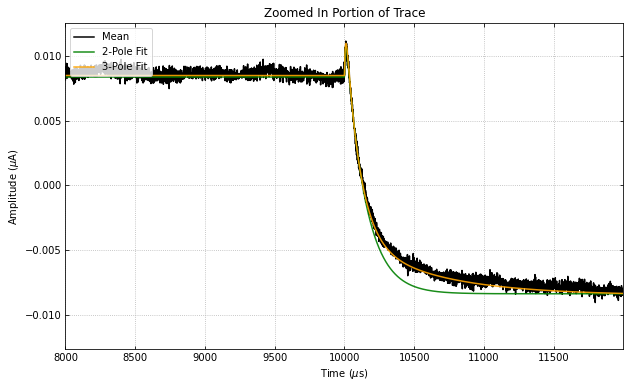

45
qetbias: -2.2 r0: 0.1 i0: -0.9 ptes: 0.0 tauplus: 0.3 tauminus: 47.8 3pole tauplus: 0.0 3pole tauminus: 0.0 3pole tau3: 47.8


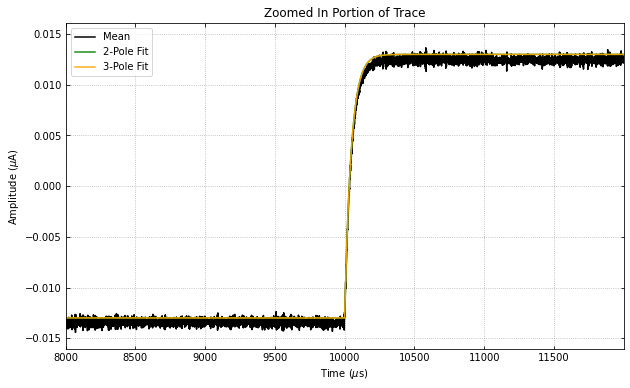

46
qetbias: -1.8 r0: 0.0 i0: -0.7 ptes: 0.0 tauplus: 0.2 tauminus: 48.3 3pole tauplus: 0.1 3pole tauminus: 0.2 3pole tau3: 48.3


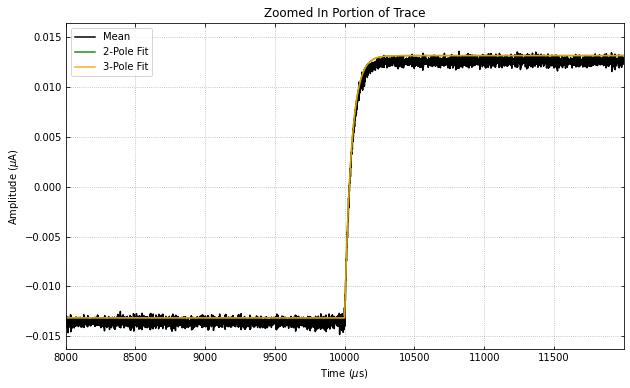

47
qetbias: -1.4 r0: 0.0 i0: -0.6 ptes: 0.0 tauplus: 0.2 tauminus: 48.6 3pole tauplus: 0.0 3pole tauminus: 0.4 3pole tau3: 48.6


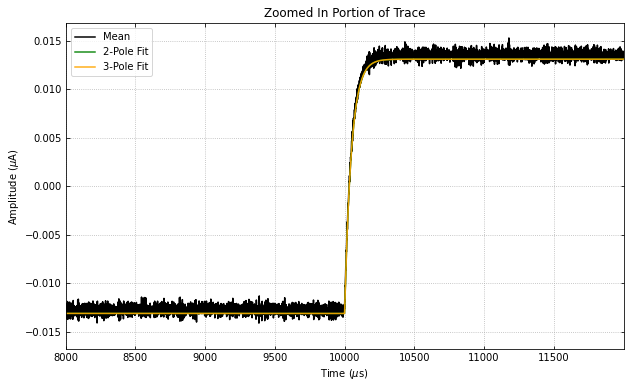

In [32]:
#'''
for index, row in IVobj_irptsmall.df[IVobj_irptsmall.didvinds].iloc[IVobj_irptsmall.traninds].iterrows():
    print(index)
    print(
        f"qetbias: {row['qetbias'] * 1e6:.1f}",
        f"r0: {row['r0'] * 1e3:.1f}",
        f"i0: {row['i0'] * 1e6:.1f}",
        f"ptes: {row['ptes'] * 1e12:.1f}",
        f"tauplus: {row['didvobj'].fitresult(2)['falltimes'][0] * 1e6:.1f}",
        f"tauminus: {row['didvobj'].fitresult(2)['falltimes'][1] * 1e6:.1f}",
        f"3pole tauplus: {row['didvobj'].fitresult(3)['falltimes'][0] * 1e6:.1f}",
        f"3pole tauminus: {row['didvobj'].fitresult(3)['falltimes'][1] * 1e6:.1f}",
        f"3pole tau3: {row['didvobj'].fitresult(3)['falltimes'][2] * 1e6:.1f}",
    )
    savename = 'L25Pc' + f"{row['qetbias'] * 1e6:.1f}"
    row['didvobj_p'].plot_zoomed_in_trace(
        zoomfactor=0.2, saveplot=False, savepath=save_path, savename=savename,
 )
    #''';

## Big

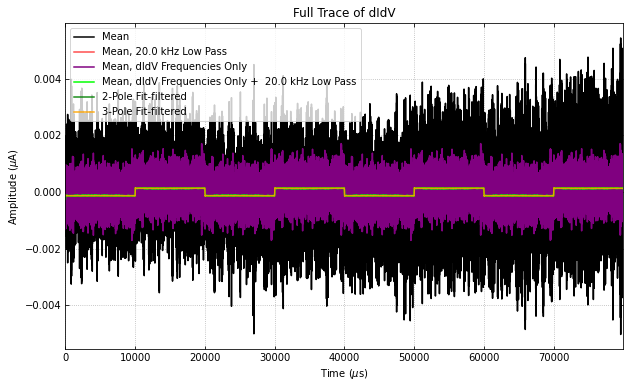

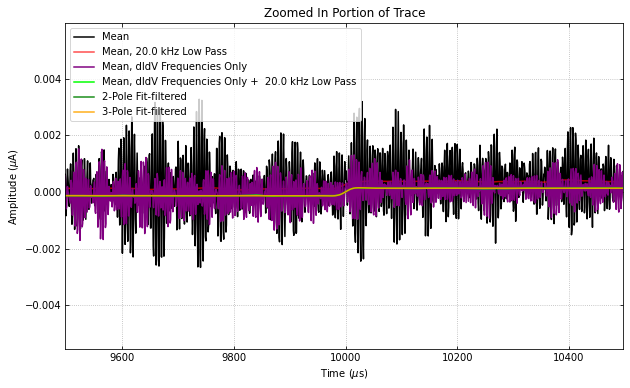

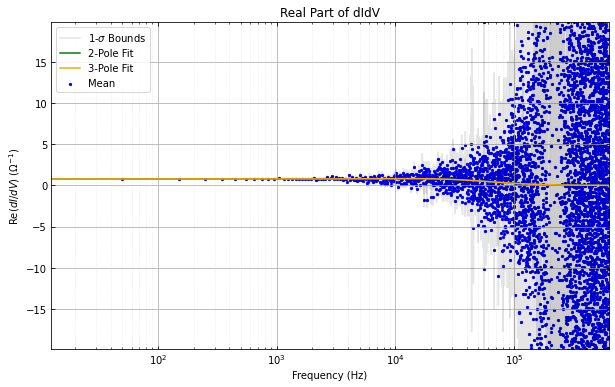

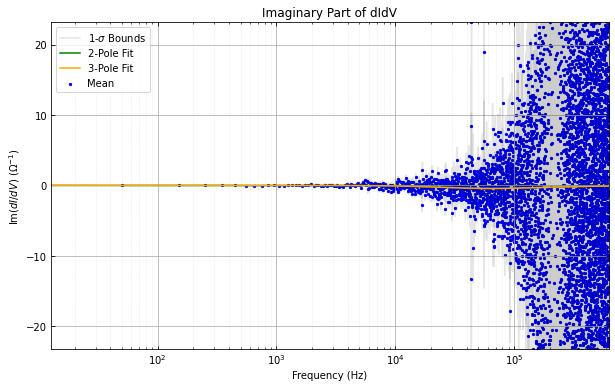

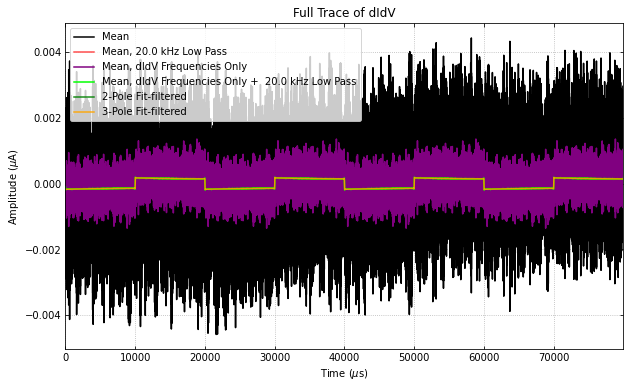

...

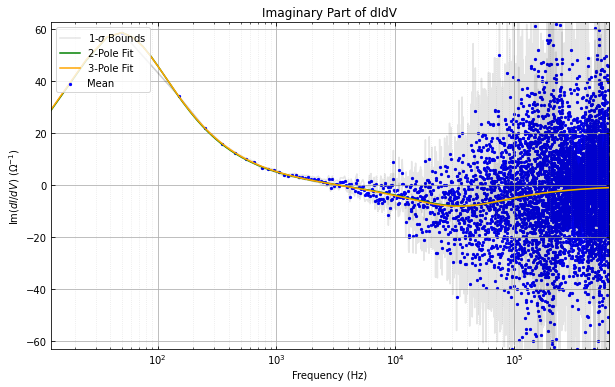

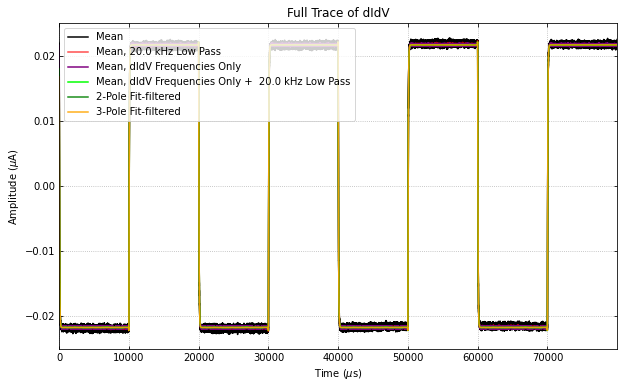

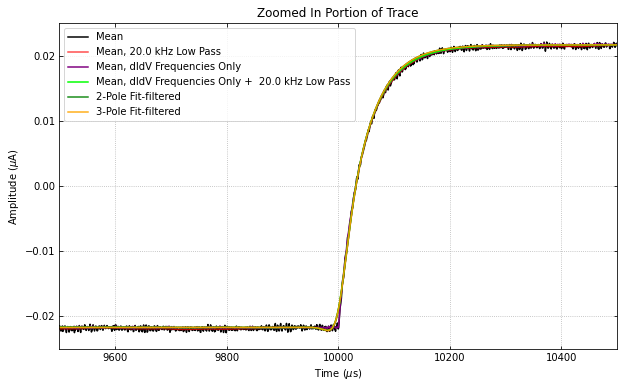

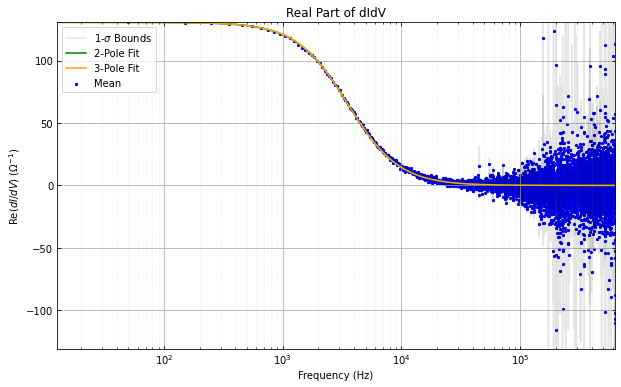

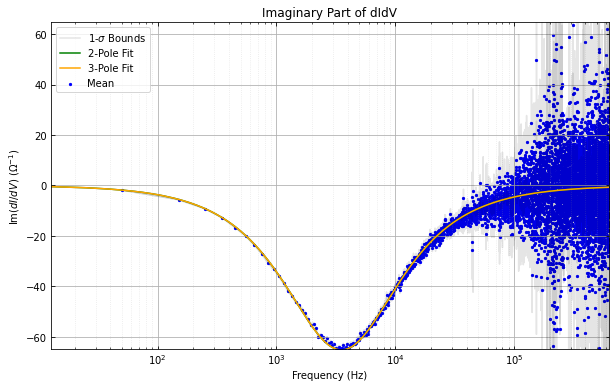

In [44]:
IVobj_irptbig.fit_tran_didv(lgcplot=True, lp_cutoff=20e3, zoomfactor=0.05)


32
qetbias: -12.0 r0: 834.8 i0: -0.1 ptes: 0.0 tauplus: 0.3 tauminus: 999.1 3pole tauplus: 0.3 3pole tauminus: 715.3 3pole tau3: 4003.3


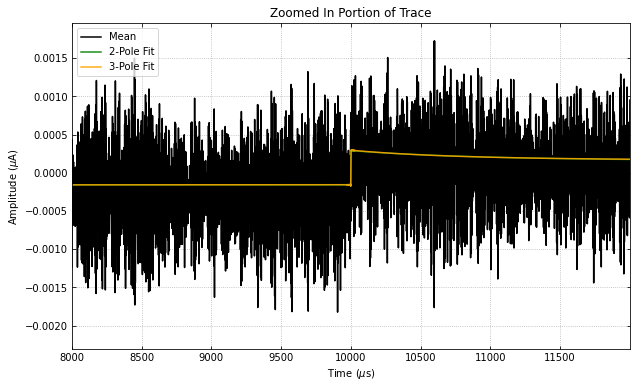

33
qetbias: -10.0 r0: 751.5 i0: -0.1 ptes: 0.0 tauplus: 1.2 tauminus: 548.5 3pole tauplus: 1.3 3pole tauminus: 293.5 3pole tau3: 1131.8


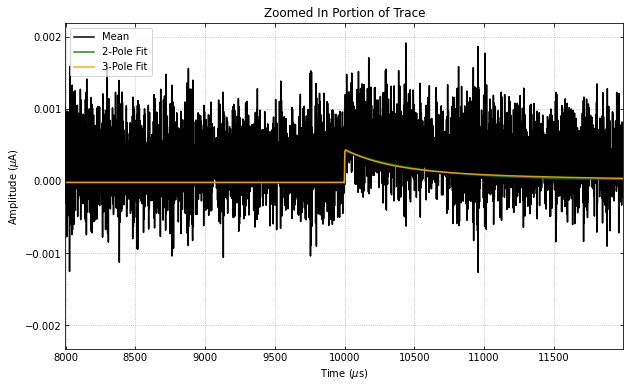

34
qetbias: -8.0 r0: 563.8 i0: -0.1 ptes: 0.0 tauplus: 0.5 tauminus: 198.7 3pole tauplus: 0.6 3pole tauminus: 136.0 3pole tau3: 999.0


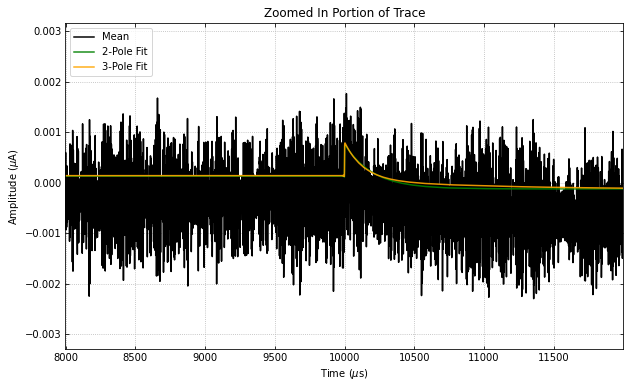

35
qetbias: -7.0 r0: 446.4 i0: -0.1 ptes: 0.0 tauplus: 0.6 tauminus: 132.7 3pole tauplus: 0.7 3pole tauminus: 87.4 3pole tau3: 611.7


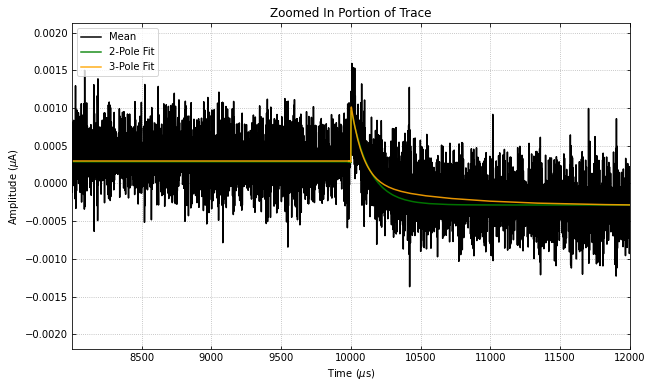

36
qetbias: -6.0 r0: 323.4 i0: -0.1 ptes: 0.0 tauplus: 0.6 tauminus: 103.2 3pole tauplus: 0.7 3pole tauminus: 74.5 3pole tau3: 508.8


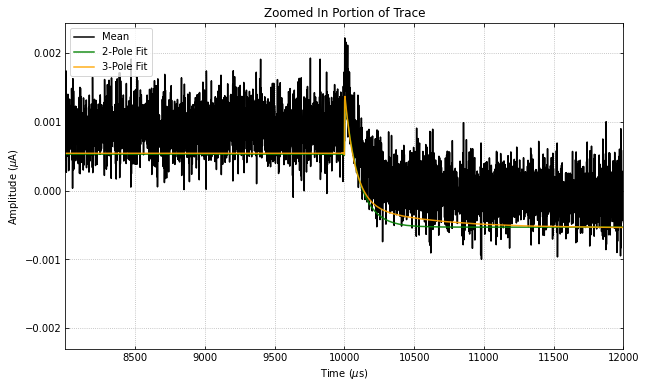

37
qetbias: -5.0 r0: 219.5 i0: -0.1 ptes: 0.0 tauplus: 1.4 tauminus: 85.5 3pole tauplus: 1.7 3pole tauminus: 65.4 3pole tau3: 497.0


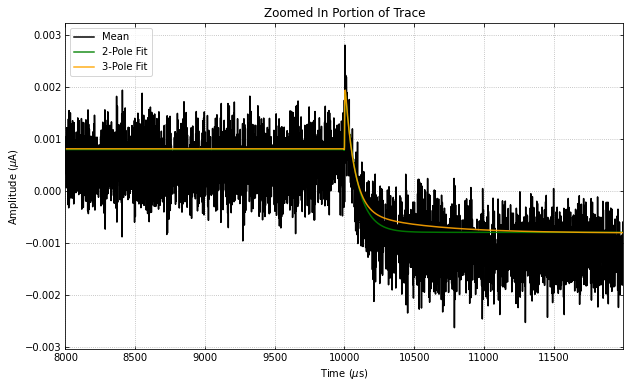

38
qetbias: -4.5 r0: 174.3 i0: -0.1 ptes: 0.0 tauplus: 1.6 tauminus: 80.3 3pole tauplus: 1.9 3pole tauminus: 66.5 3pole tau3: 731.9


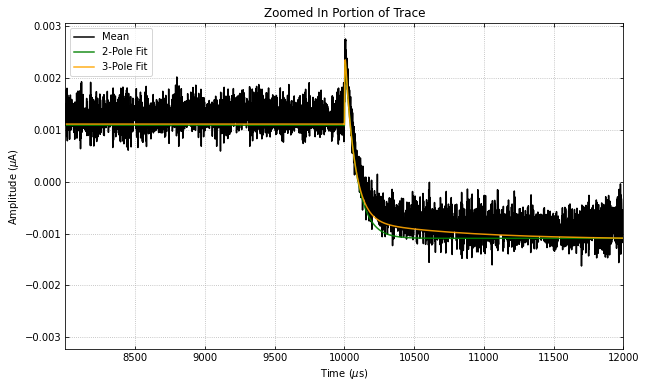

39
qetbias: -4.2 r0: 146.5 i0: -0.1 ptes: 0.0 tauplus: 1.7 tauminus: 80.8 3pole tauplus: 1.9 3pole tauminus: 69.5 3pole tau3: 795.2


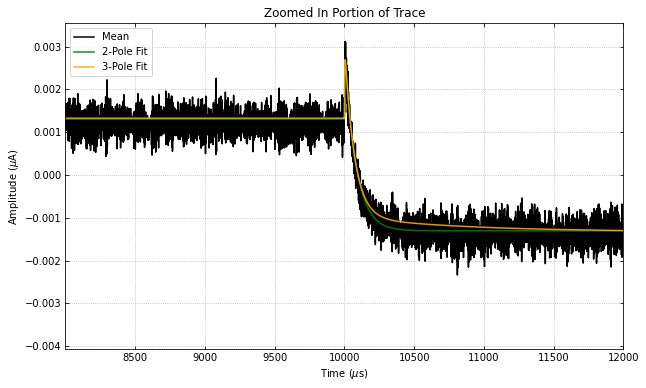

40
qetbias: -3.9 r0: 120.8 i0: -0.2 ptes: 0.0 tauplus: 1.9 tauminus: 77.9 3pole tauplus: 2.3 3pole tauminus: 60.8 3pole tau3: 417.0


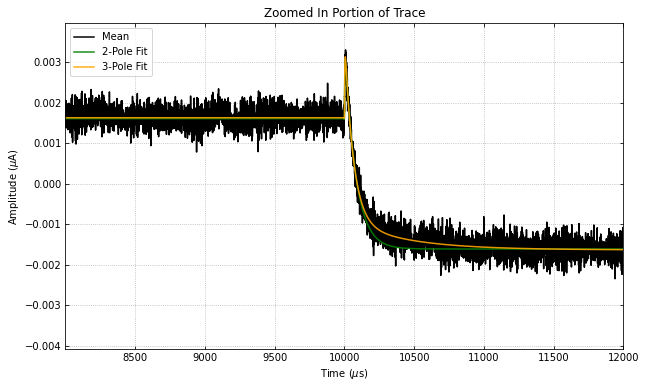

41
qetbias: -3.6 r0: 103.0 i0: -0.2 ptes: 0.0 tauplus: 2.4 tauminus: 77.1 3pole tauplus: 2.8 3pole tauminus: 61.2 3pole tau3: 418.8


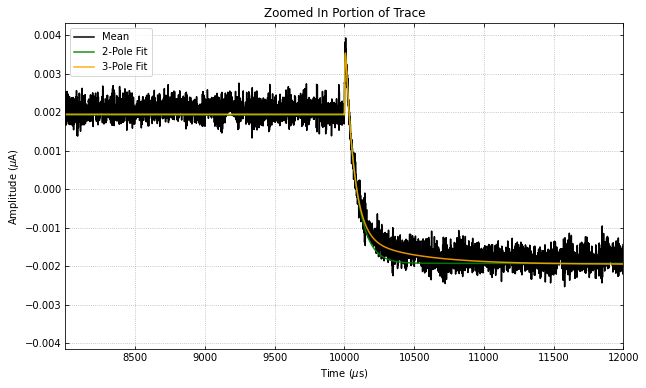

42
qetbias: -3.3 r0: 81.5 i0: -0.2 ptes: 0.0 tauplus: 2.6 tauminus: 78.4 3pole tauplus: 3.2 3pole tauminus: 61.9 3pole tau3: 462.2


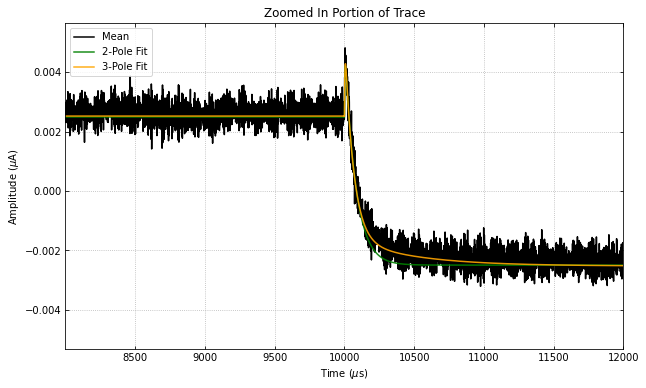

43
qetbias: -3.0 r0: 61.7 i0: -0.2 ptes: 0.0 tauplus: 3.4 tauminus: 83.3 3pole tauplus: 4.2 3pole tauminus: 64.4 3pole tau3: 415.7


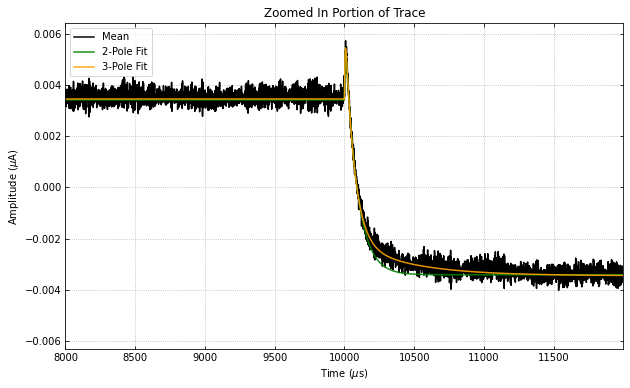

44
qetbias: -2.6 r0: 40.0 i0: -0.3 ptes: 0.0 tauplus: 4.4 tauminus: 95.6 3pole tauplus: 5.2 3pole tauminus: 76.2 3pole tau3: 487.9


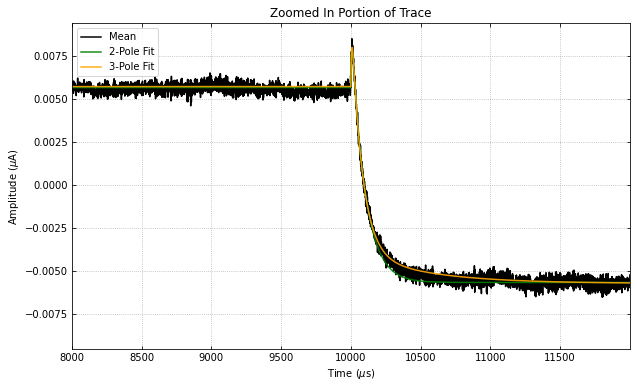

45
qetbias: -2.2 r0: 24.8 i0: -0.3 ptes: 0.0 tauplus: 6.2 tauminus: 116.5 3pole tauplus: 7.3 3pole tauminus: 94.9 3pole tau3: 657.4


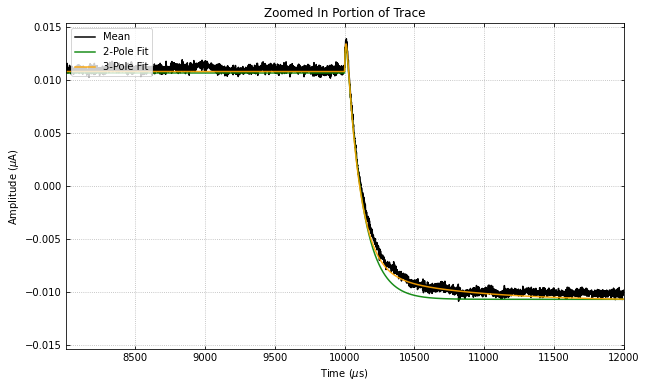

46
qetbias: -1.8 r0: -0.0 i0: -1.2 ptes: -0.0 tauplus: 0.1 tauminus: 69.6 3pole tauplus: 0.0 3pole tauminus: 0.7 3pole tau3: 69.6


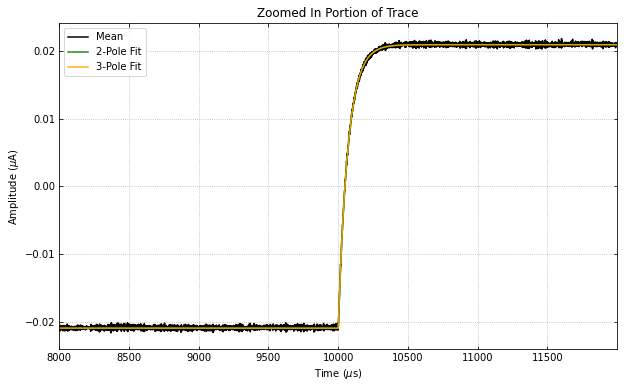

47
qetbias: -1.4 r0: -0.0 i0: -0.9 ptes: -0.0 tauplus: 0.0 tauminus: 69.6 3pole tauplus: 0.0 3pole tauminus: 0.1 3pole tau3: 69.6


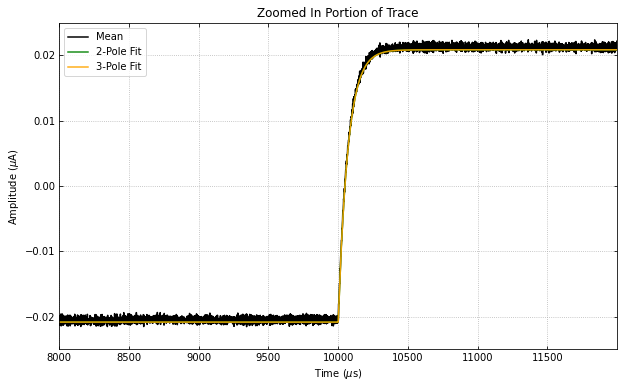

In [34]:
#'''
for index, row in IVobj_irptbig.df[IVobj_irptbig.didvinds].iloc[IVobj_irptbig.traninds].iterrows():
    print(index)
    print(
        f"qetbias: {row['qetbias'] * 1e6:.1f}",
        f"r0: {row['r0'] * 1e3:.1f}",
        f"i0: {row['i0'] * 1e6:.1f}",
        f"ptes: {row['ptes'] * 1e12:.1f}",
        f"tauplus: {row['didvobj'].fitresult(2)['falltimes'][0] * 1e6:.1f}",
        f"tauminus: {row['didvobj'].fitresult(2)['falltimes'][1] * 1e6:.1f}",
        f"3pole tauplus: {row['didvobj'].fitresult(3)['falltimes'][0] * 1e6:.1f}",
        f"3pole tauminus: {row['didvobj'].fitresult(3)['falltimes'][1] * 1e6:.1f}",
        f"3pole tau3: {row['didvobj'].fitresult(3)['falltimes'][2] * 1e6:.1f}",
    )
    savename = 'R25Pc' + f"{row['qetbias'] * 1e6:.1f}"
    row['didvobj_p'].plot_zoomed_in_trace(
        zoomfactor=0.2, saveplot=False, savepath=save_path, savename=savename,
 )
#''';

# Noise

## alo3

In [25]:
IVobj_alo3.tc = 44e-3
#IVobj.tbath = 4.5e-3 #I do not know what these values were
#IVobj.tload = 65e-3
IVobj_alo3.Gta = 5 * IVobj_alo3.df[IVobj_alo3.didvinds].iloc[9]['ptes']/IVobj_alo3.tc

In [26]:
# noise modeling
IVobj_alo3.fit_normal_noise(fit_range = [1e2, 1e5], lgcplot=False, lgcsave=False)

In [27]:
IVobj_alo3.fit_sc_noise(fit_range = [1e2, 1e5], lgcplot=False, lgcsave=False)

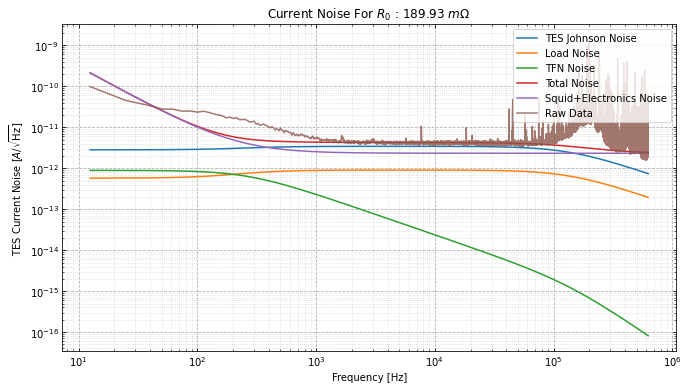

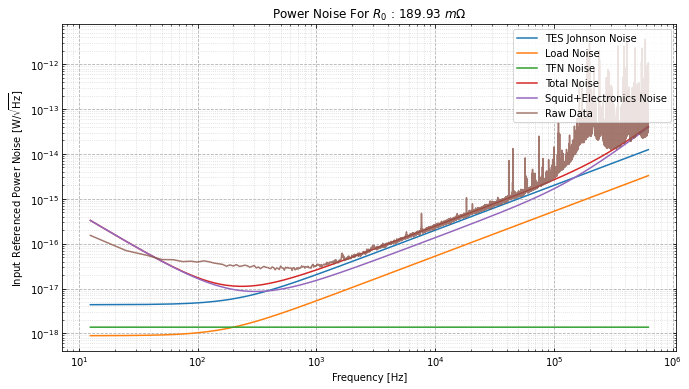

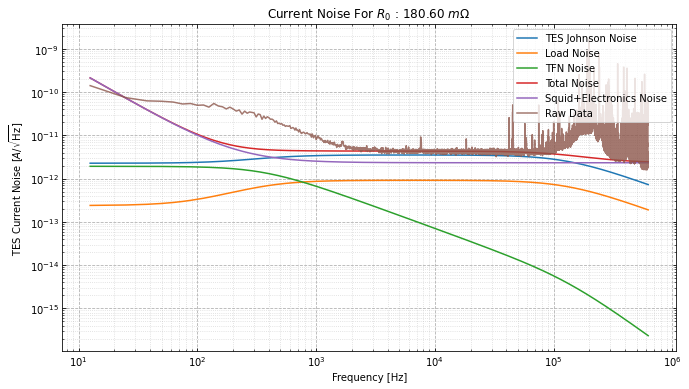

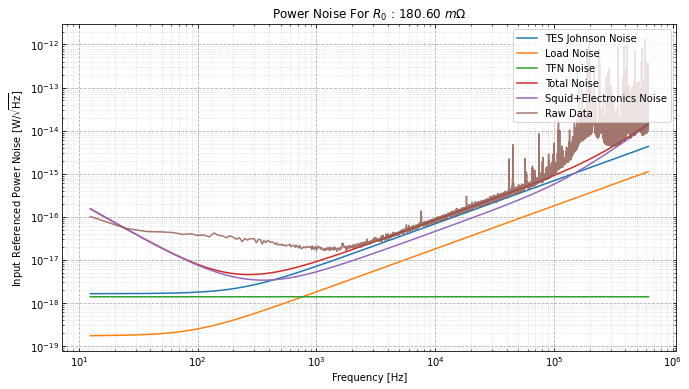

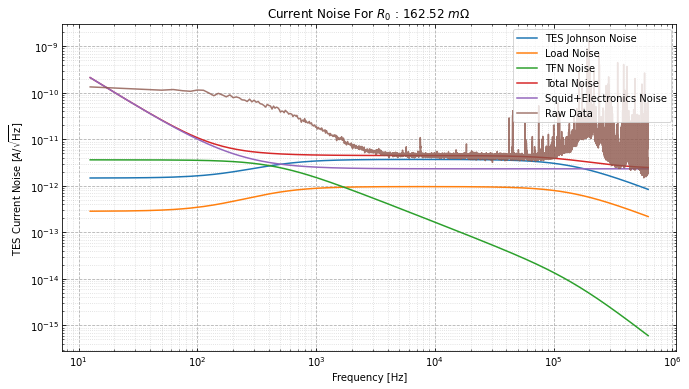

...

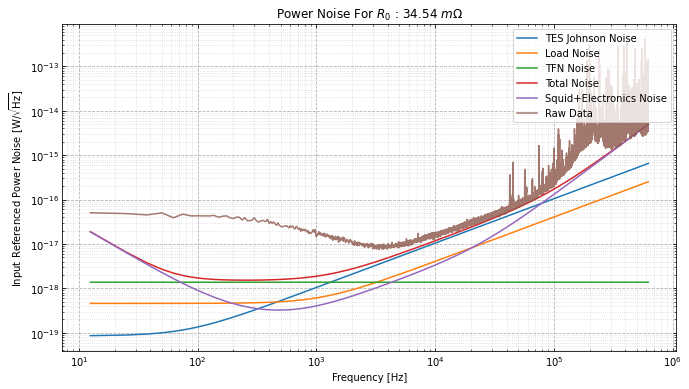

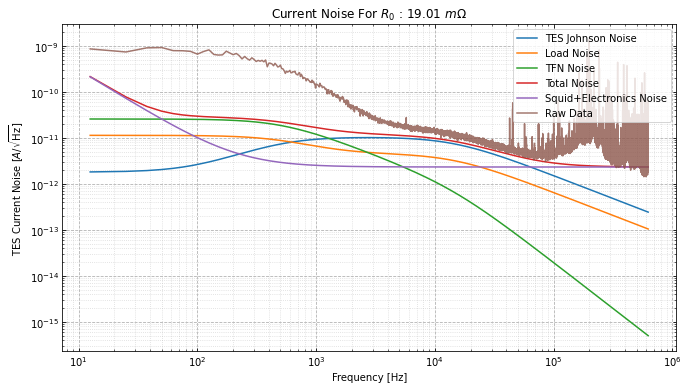

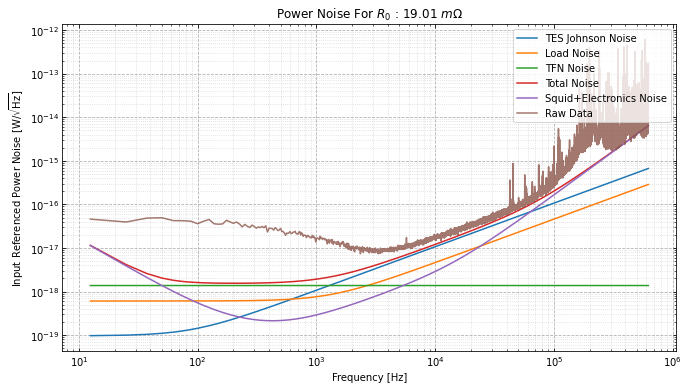

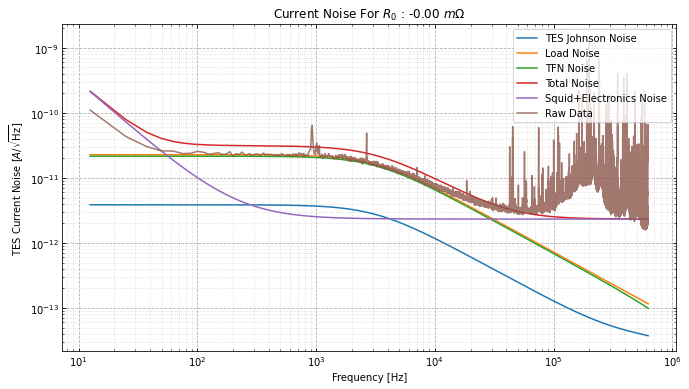

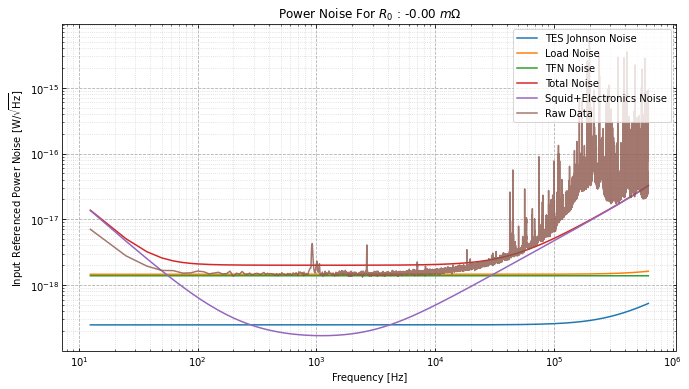

In [28]:
# using  default collection efficiency = 1
IVobj_alo3.model_noise_simple(lgcplot=True, lgcsave=False,collection_eff=1)

In [ ]:
#Need to pull the whole noise data frame and save so I can plot it against the other runs. 


In [30]:
from qetpy.sim import TESnoise

In [31]:
IVobj = IVobj_alo3

trandf = IVobj.df.loc[IVobj.noiseinds].iloc[IVobj.traninds]
r0s_rn_arr = trandf.r0.values/IVobj.rn_iv
inds = np.arange(len(IVobj.traninds))
sp_arr = []
qetbias_arr=[]
f_arr = []
psd_arr = []
for ind in inds:
    noise_row = trandf.iloc[ind]
    f = noise_row.f[1:]
    qetbias_arr.append(noise_row.qetbias)
    psd = noise_row.psd[1:]
    didvobj = noise_row.didvobj_p
    nsamples=len(IVobj.traninds)
    tes_params = IVobj._get_tes_params(
        didvobj, nsamples=nsamples,
    )
    f_arr.append(f)
    psd_arr.append(psd)
    rshunt, rp, r0, beta, l, L, tau0, tc, tb, gta = tes_params
    tesnoise = TESnoise(
        freqs=f,
        rload=rp[ind] + rshunt[ind],
        r0=r0[ind],
        rshunt=rshunt[ind],
        beta=beta[ind],
        loopgain=l[ind],
        inductance=L[ind],
        tau0=tau0[ind],
        G=gta[ind],
        qetbias=noise_row.qetbias,
        tc=tc[ind],
        tload=IVobj.tload,
        tbath=tb[ind],
        n=5.0,
        lgcb=True,
        squiddc=IVobj.squiddc,
        squidpole=IVobj.squidpole,
        squidn=IVobj.squidn,
    )
    Sp_res = psd/(np.abs(tesnoise.dIdP(f))**2)
    sp_arr.append(Sp_res)

In [33]:
dpdi_dict = {}
dpdi_dict['qetbias'] = qetbias_arr
dpdi_dict['f'] = f_arr
dpdi_dict['psd'] = psd_arr
dpdi_dict['sp'] = sp_arr

In [34]:
savename = 'r35_powernoise'
dpdi_save_path = '/home/maggie_reed/processing/run38/RQfiles/'
#print(f'Dumping run dpdi as: ',  savename)
with open(dpdi_save_path + savename, 'wb') as handle:
    pickle.dump(dpdi_dict, handle, protocol=pickle.HIGHEST_PROTOCOL)

In [39]:
# noise errors
IVobj_alo3.estimate_noise_errors(tau_collect=0, collection_eff=1, nsamples=500)


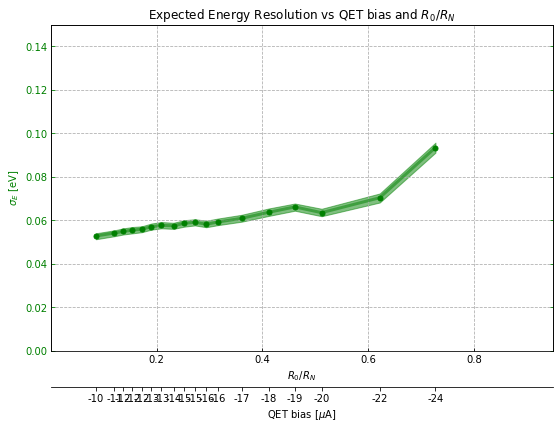

(-8.012827838827832e-06, 6.304095499754477e-05, 0.003910160134295548)

In [40]:
IVobj_alo3.find_optimum_bias(lgcplot=True, ylims=[0, 0.15])


In [41]:
print("Bias (uA), R0 (mOhms), I0 (nA), PTES (fW), tauplus, tauminus, 3pole tauplus, 3pole tau minus, tau3")

for index, row in IVobj_1pc.df[IVobj_1pc.didvinds].iloc[0:-1].iterrows():
    print(
        f"{row['qetbias'] * 1e6:.1f}     ",
        f"{row['r0'] * 1e3:.1f}       ",
        f"{row['i0'] * 1e9:.1f}    ",
        f"{row['ptes'] * 1e15:.1f}    ",
        f"{row['didvobj'].fitresult(2).get('params', {'tau1':0}).get('tau1')*1e6:.1f}",
        f"{row['didvobj'].fitresult(2).get('params', {'tau2':0}).get('tau2')*1e6:.1f}",
        f"{row['didvobj'].fitresult(3).get('params', {'tau1':0}).get('tau1')*1e6:.1f}",
        f"{row['didvobj'].fitresult(3).get('params', {'tau2':0}).get('tau2')*1e6:.1f}",
        f"{row['didvobj'].fitresult(3).get('params', {'tau3':0}).get('tau3')*1e6:.1f}",
        #f"{row['didvobj'].fitresult(3)['falltimes'][0] * 1e6:.1f}",
        #f"{row['didvobj'].fitresult(3)['falltimes'][1] * 1e6:.1f}",
        #f"{row['didvobj'].fitresult(3)['falltimes'][2] * 1e6:.1f}",
    )

Bias (uA), R0 (mOhms), I0 (nA), PTES (fW), tauplus, tauminus, 3pole tauplus, 3pole tau minus, tau3
-80.0      327.3        -1189.5     463.1     0.0 0.0 0.0 0.0 0.0
-70.0      327.5        -1039.9     354.2     0.0 0.0 0.0 0.0 0.0
-60.0      327.9        -891.3     260.5     0.0 0.0 0.0 0.0 0.0
-50.0      328.2        -742.0     180.7     0.0 0.0 0.0 0.0 0.0
-40.0      327.6        -594.4     115.7     0.0 0.0 0.0 0.0 0.0
-35.0      325.3        -524.2     89.4     0.0 0.0 0.0 0.0 0.0
-30.0      310.5        -469.4     68.4     1337.0 0.6 360.9 1.0 487.5
-28.0      295.2        -461.0     62.7     2113.5 1.1 350.5 1.7 398.6
-26.0      270.6        -465.2     58.5     -749.3 0.4 -3123310740.3 1.0 434.2
-24.0      238.0        -485.4     56.1     -260.1 0.8 -352.1 1.3 295.0
-22.0      203.6        -518.0     54.6     -121.3 1.2 -130.4 1.8 350.2
-20.0      167.7        -565.8     53.7     -94.0 1.7 -102.8 2.3 205.4
-19.0      151.1        -594.0     53.3     -97.7 1.8 -107.5 2.5 230.5
-18

## Small

In [141]:
IVobj_irptsmall.tc = 46.5e-3 #this is from the run25 Tc note on the google drive 
#IVobj.tbath = 4.5e-3 #I do not knowwhat these values were
#IVobj.tload = 65e-3
IVobj_irptsmall.Gta = 5 * IVobj_irptsmall.df[IVobj_irptsmall.didvinds].iloc[9]['ptes']/IVobj_irptsmall.tc

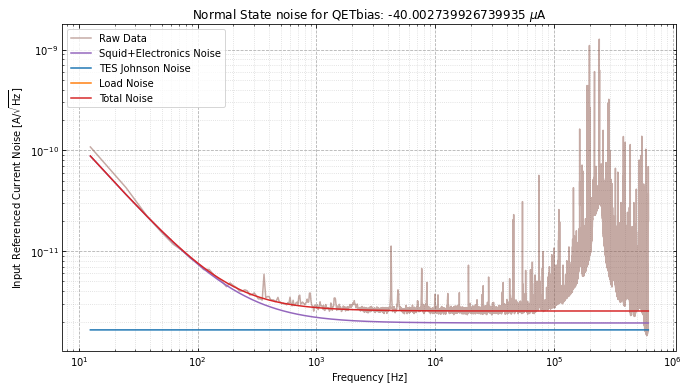

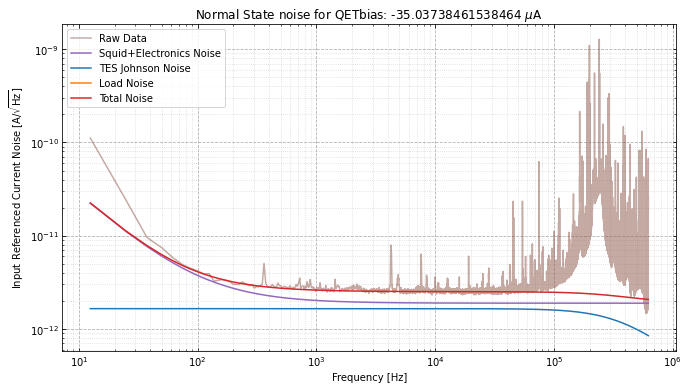

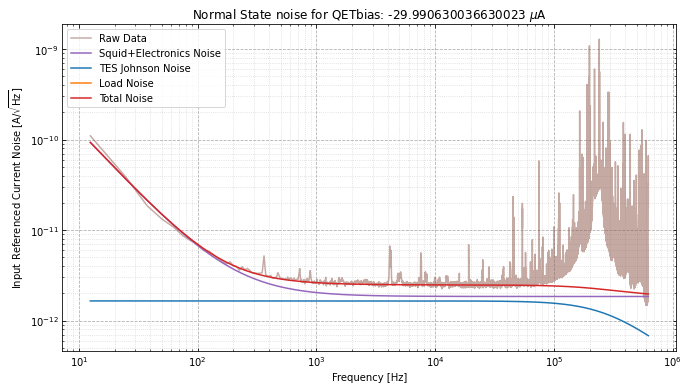

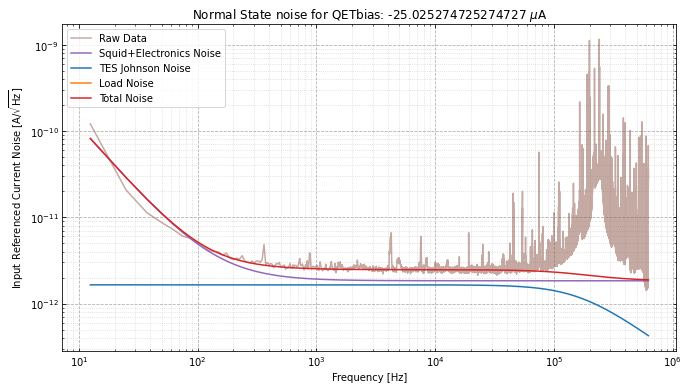

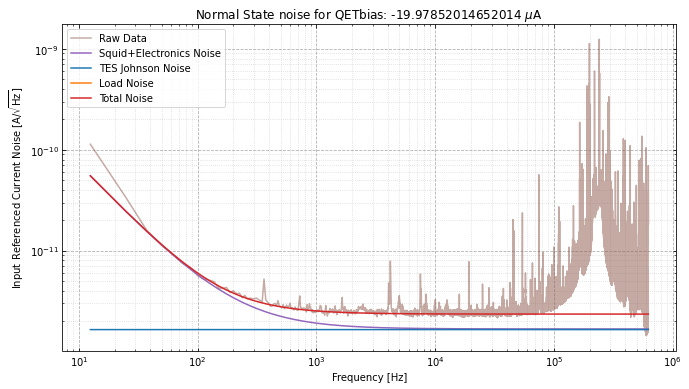

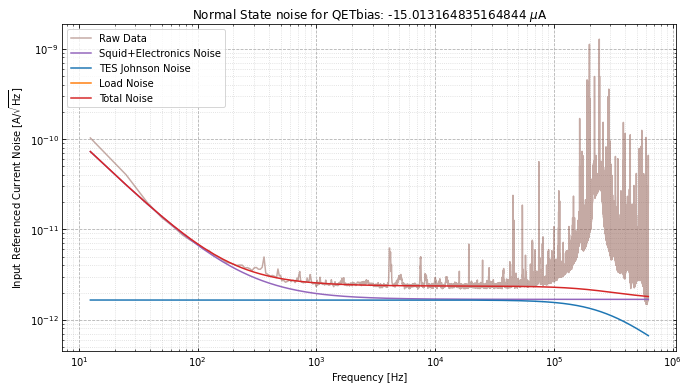

In [142]:
# noise modeling
IVobj_irptsmall.fit_normal_noise(fit_range = [1e2, 1e5], lgcplot=False, lgcsave=False)

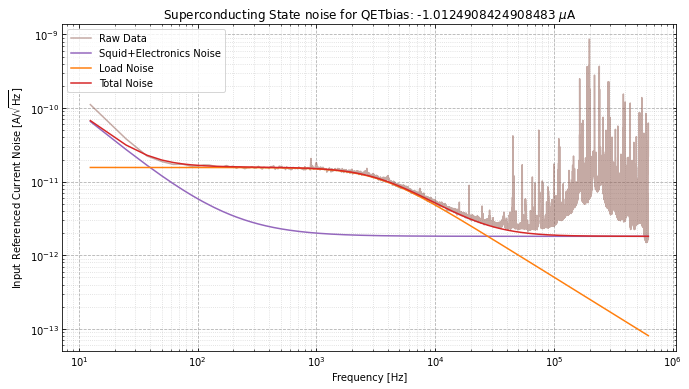

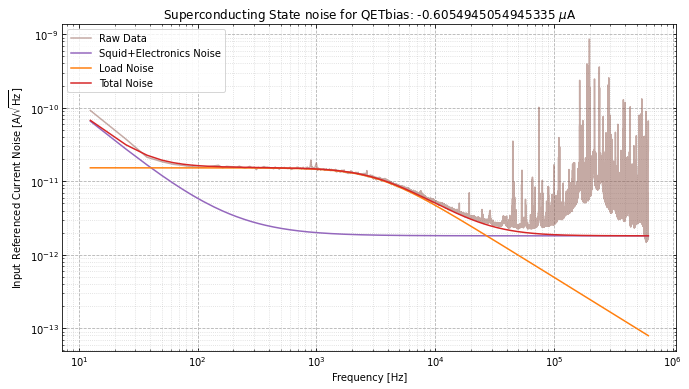

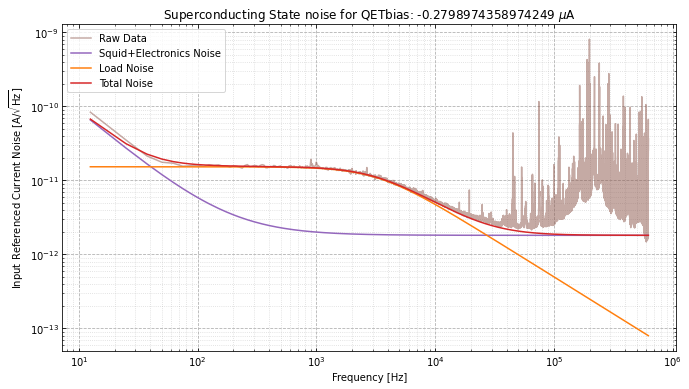

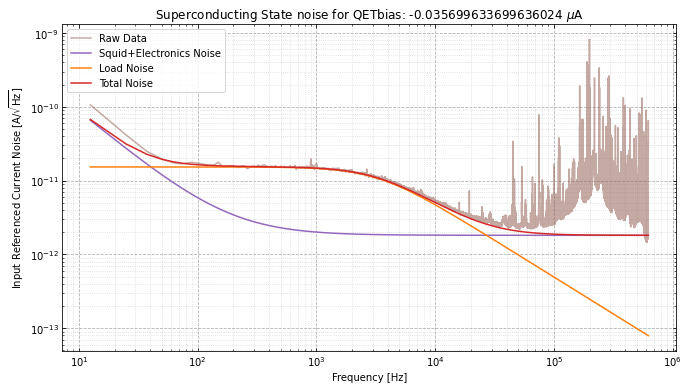

In [143]:
IVobj_irptsmall.fit_sc_noise(fit_range = [1e2, 1e5], lgcplot=False, lgcsave=False)

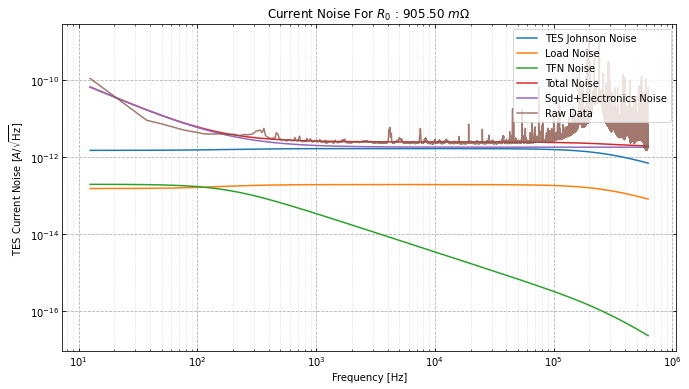

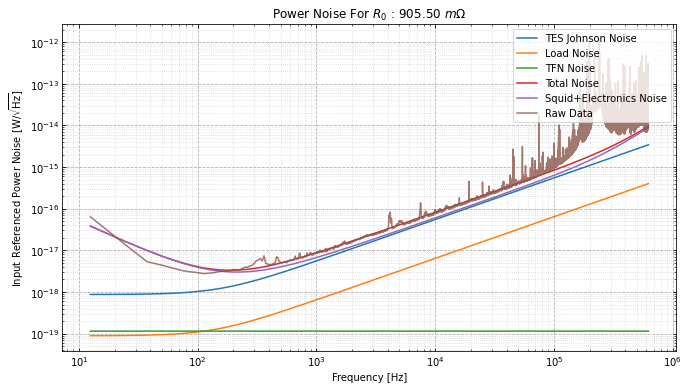

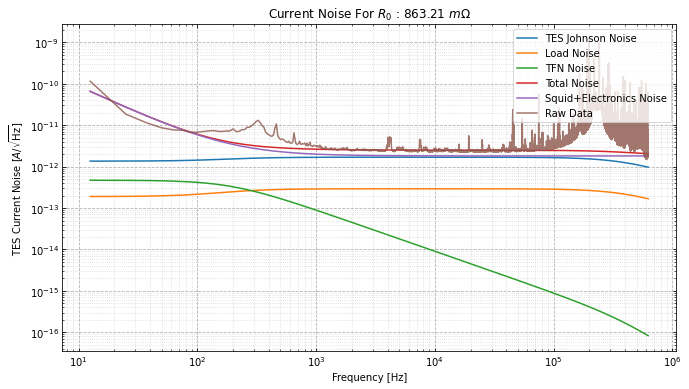

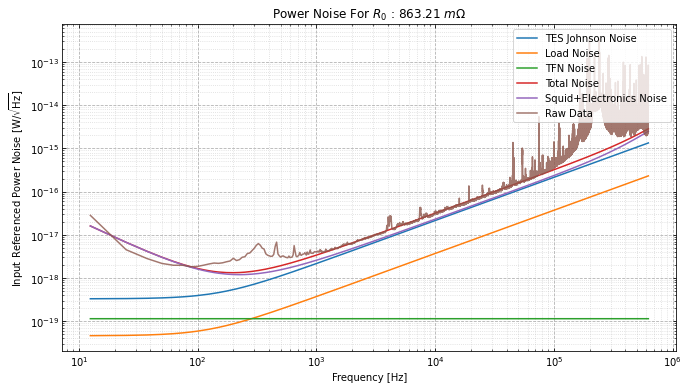

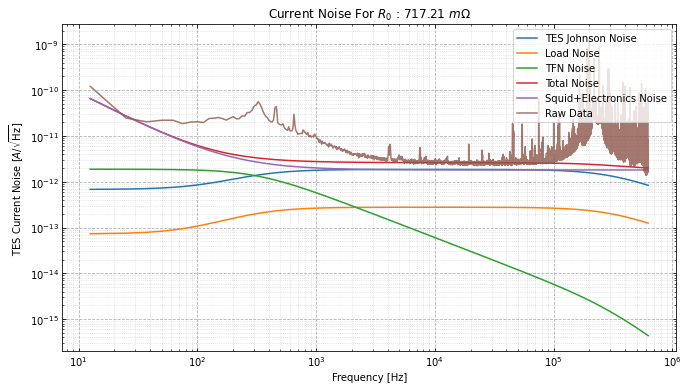

...

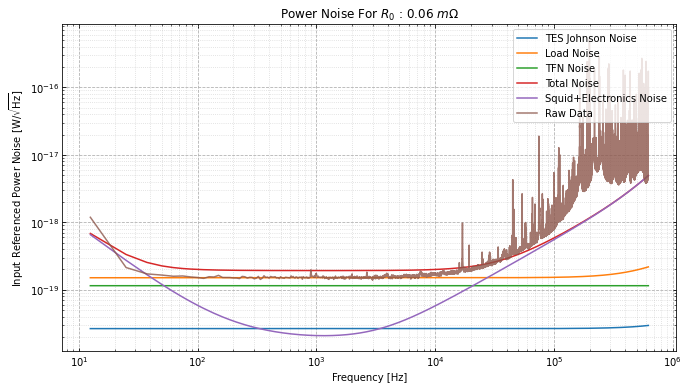

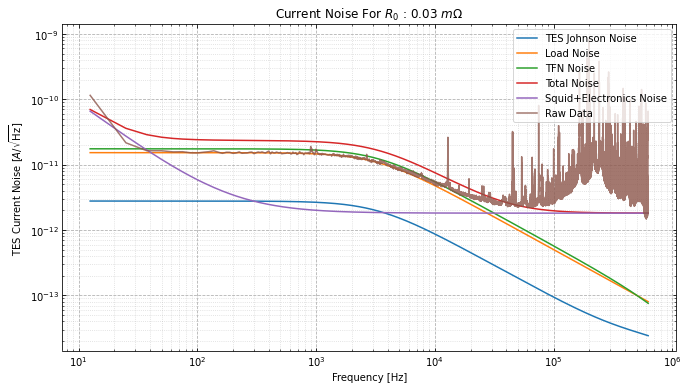

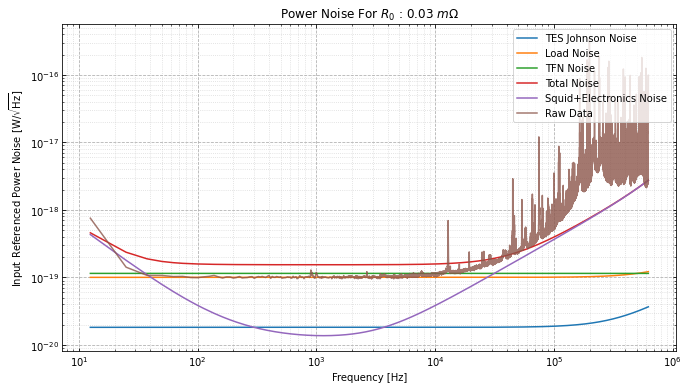

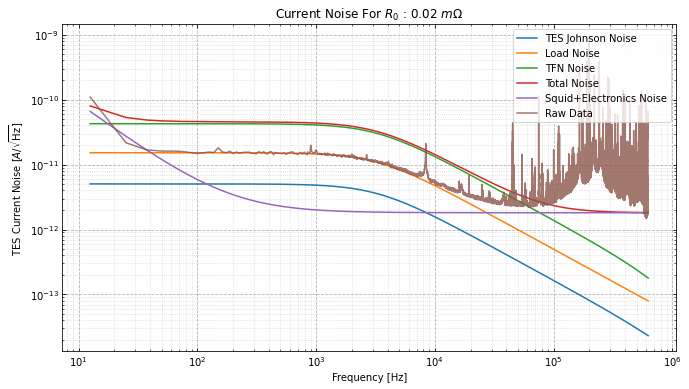

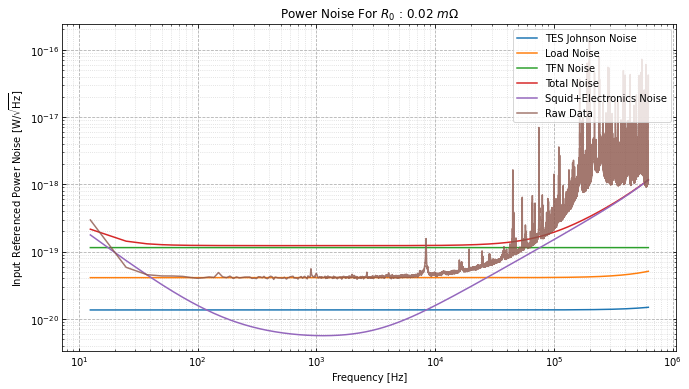

In [145]:
# using  default collection efficiency = 1
IVobj_irptsmall.model_noise_simple(lgcplot=True, lgcsave=False,collection_eff=1)

In [146]:
# noise errors
IVobj_irptsmall.estimate_noise_errors(tau_collect=0, collection_eff=1, nsamples=500)

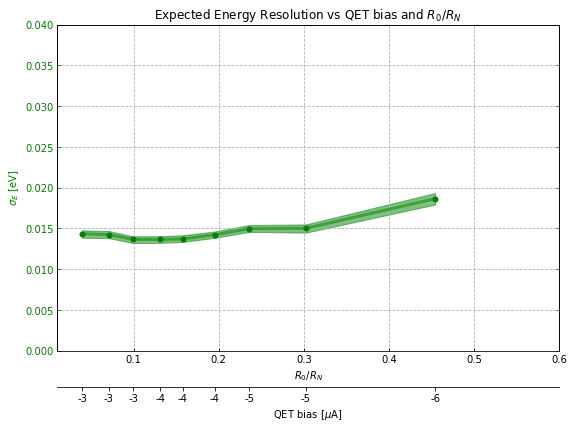

(-1.4194871794871914e-06, 1.5135666711403797e-05, 0.0009090395786869726)

In [149]:
IVobj_irptsmall.find_optimum_bias(lgcplot=True, ylims=[0, 0.04], xlims=[0.01,0.6])

In [150]:
print("Bias (uA), R0 (mOhms), I0 (nA), PTES (fW), tauplus, tauminus, 3pole tauplus, 3pole tau minus, tau3")

for index, row in IVobj_irptsmall.df[IVobj_irptsmall.didvinds].iloc[0:-1].iterrows():
    print(
        f"{row['qetbias'] * 1e6:.1f}     ",
        f"{row['r0'] * 1e3:.1f}       ",
        f"{row['i0'] * 1e9:.1f}    ",
        f"{row['ptes'] * 1e15:.1f}    ",
        f"{row['didvobj'].fitresult(2).get('params', {'tau1':0}).get('tau1')*1e6:.1f}",
        f"{row['didvobj'].fitresult(2).get('params', {'tau2':0}).get('tau2')*1e6:.1f}",
        f"{row['didvobj'].fitresult(3).get('params', {'tau1':0}).get('tau1')*1e6:.1f}",
        f"{row['didvobj'].fitresult(3).get('params', {'tau2':0}).get('tau2')*1e6:.1f}",
        f"{row['didvobj'].fitresult(3).get('params', {'tau3':0}).get('tau3')*1e6:.1f}",
        #f"{row['didvobj'].fitresult(3)['falltimes'][0] * 1e6:.1f}",
        #f"{row['didvobj'].fitresult(3)['falltimes'][1] * 1e6:.1f}",
        #f"{row['didvobj'].fitresult(3)['falltimes'][2] * 1e6:.1f}",
    )

Bias (uA), R0 (mOhms), I0 (nA), PTES (fW), tauplus, tauminus, 3pole tauplus, 3pole tau minus, tau3
-40.0      916.9        -215.3     42.5     0.0 0.0 0.0 0.0 0.0
-35.0      917.1        -188.6     32.6     0.0 0.0 0.0 0.0 0.0
-30.0      917.8        -161.3     23.9     0.0 0.0 0.0 0.0 0.0
-25.0      916.5        -134.8     16.7     0.0 0.0 0.0 0.0 0.0
-20.0      917.1        -107.6     10.6     0.0 0.0 0.0 0.0 0.0
-15.0      917.3        -80.8     6.0     0.0 0.0 0.0 0.0 0.0
-12.0      905.5        -65.5     3.9     1147.4 0.6 24.1 0.6 174.6
-10.0      863.2        -57.0     2.8     1274.8 0.4 853.5 0.4 1342.5
-8.0      717.2        -55.1     2.2     -1902.3 0.5 -4519918.8 0.6 914.3
-7.0      581.8        -59.4     2.1     -340.9 0.6 -528.7 0.7 535.0
-6.0      419.1        -69.5     2.0     -110.8 0.9 -123.2 1.1 538.0
-5.0      278.3        -86.4     2.1     -69.2 0.8 -74.1 0.9 437.5
-4.5      218.0        -98.4     2.1     -68.4 1.3 -72.5 1.5 345.1
-4.2      180.1        -109.2     2

## Big

In [17]:
IVobj_irptbig.tc = 46.5e-3 #this is from the run25 Tc note on the google drive 
#IVobj.tbath = 4.5e-3 #I do not know what these values were
#IVobj.tload = 65e-3
IVobj_irptbig.Gta = 5 * IVobj_irptbig.df[IVobj_irptbig.didvinds].iloc[9]['ptes']/IVobj_irptbig.tc

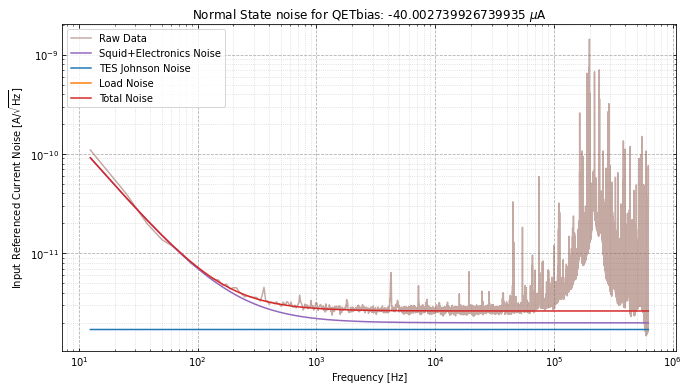

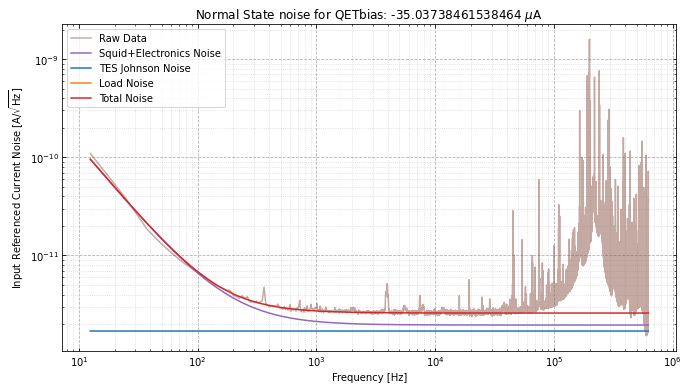

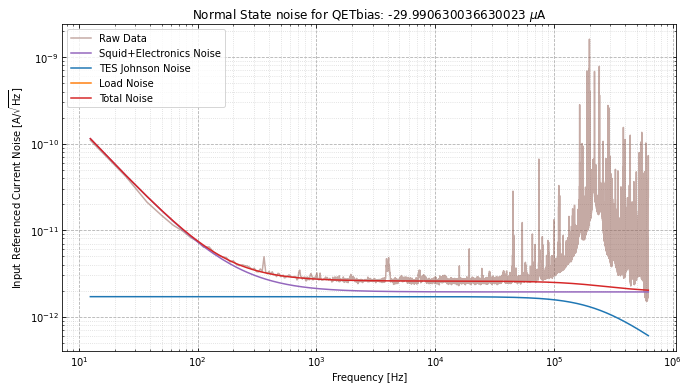

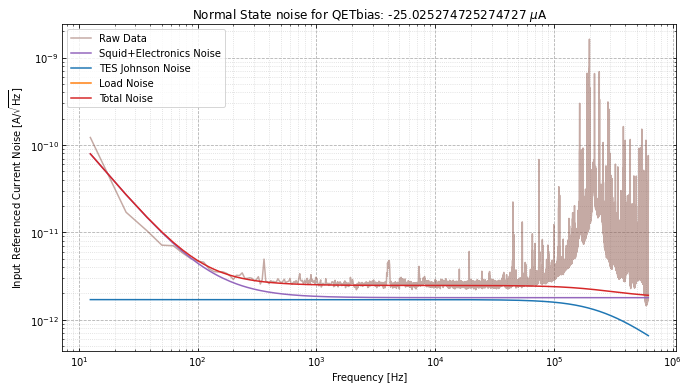

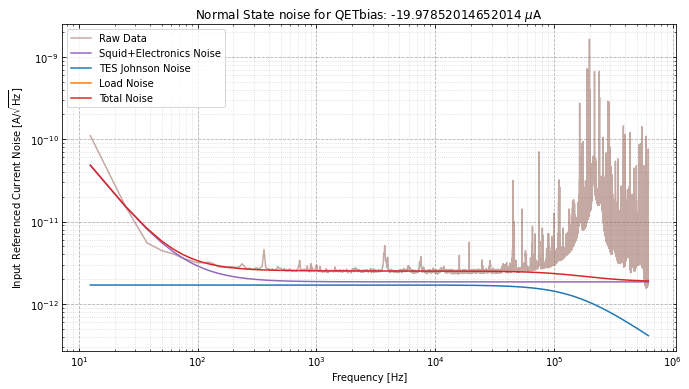

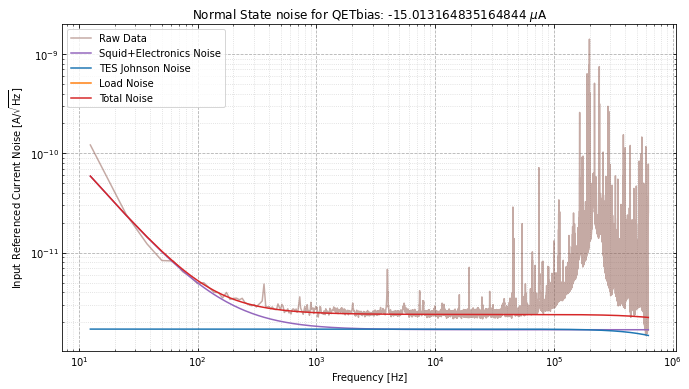

In [18]:
# noise modeling
IVobj_irptbig.fit_normal_noise(fit_range = [1e2, 1e5], lgcplot=True, lgcsave=True)

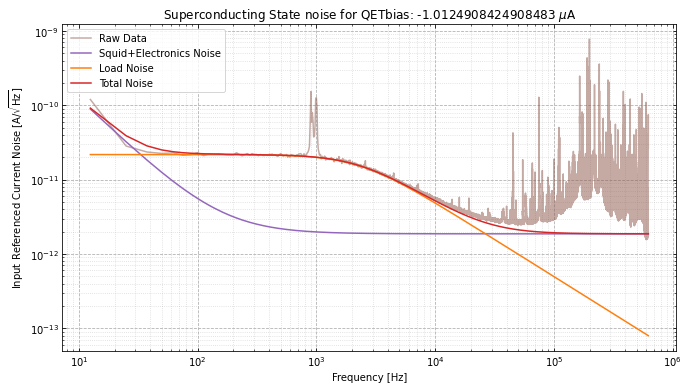

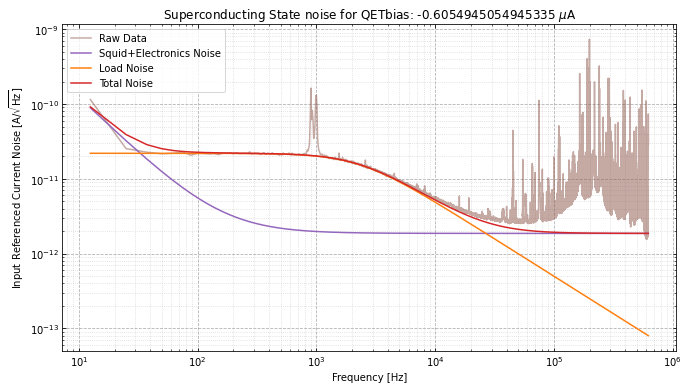

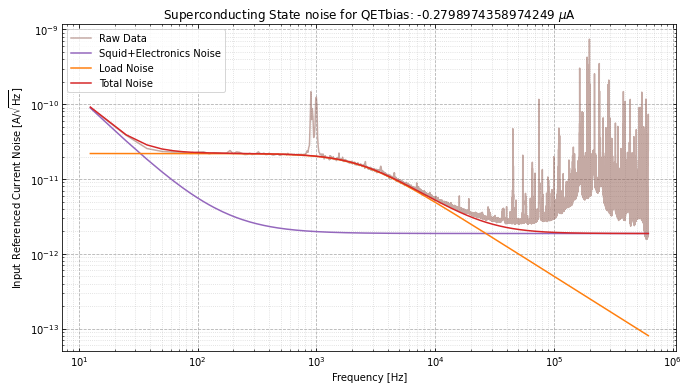

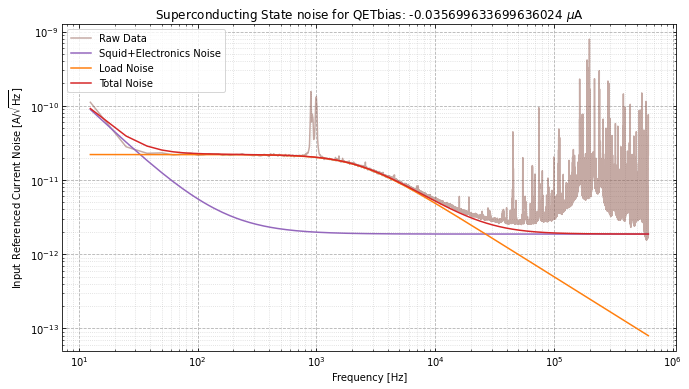

In [19]:
IVobj_irptbig.fit_sc_noise(fit_range = [1e2, 1e5], lgcplot=True, lgcsave=True)

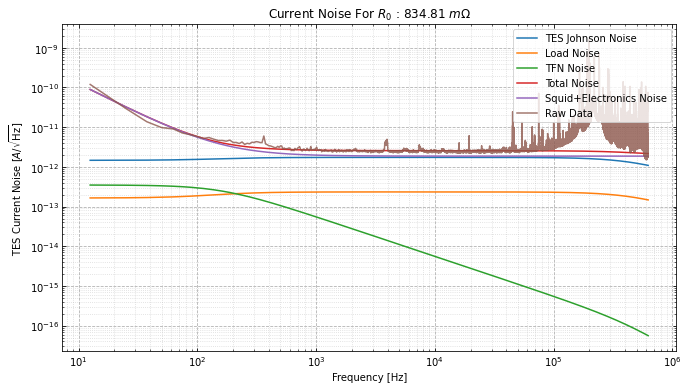

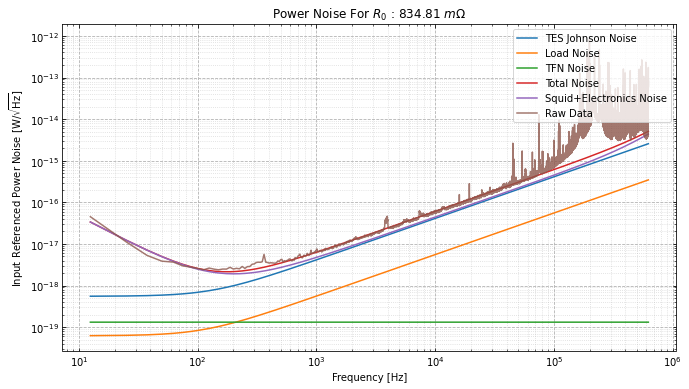

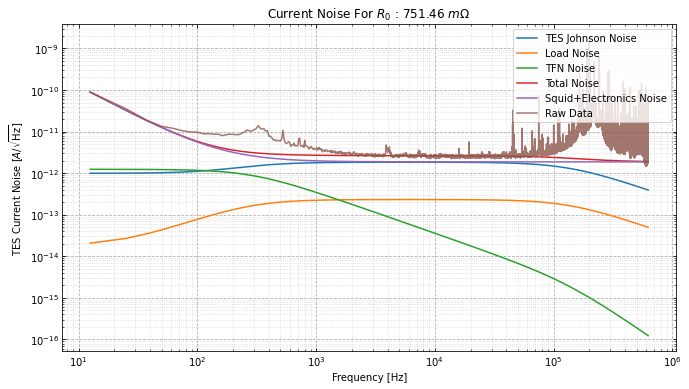

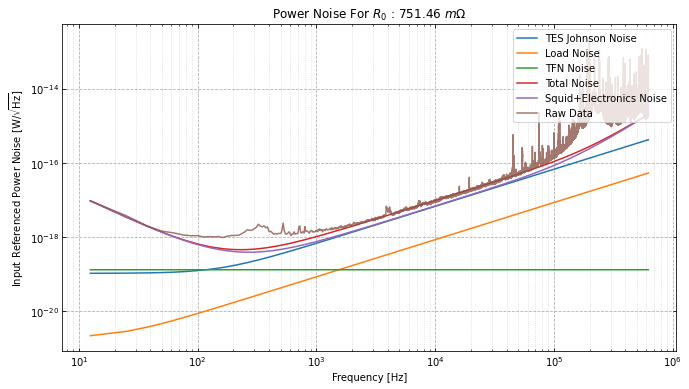

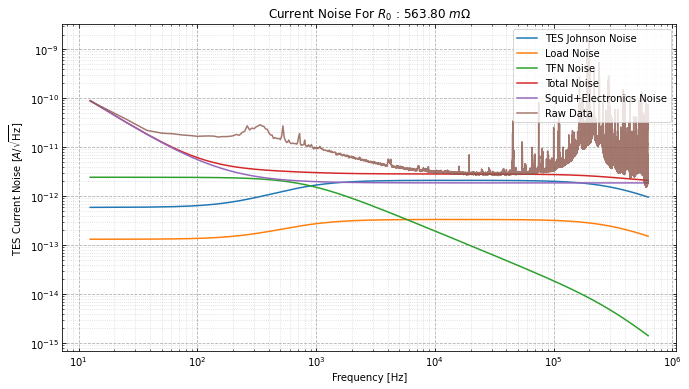

...

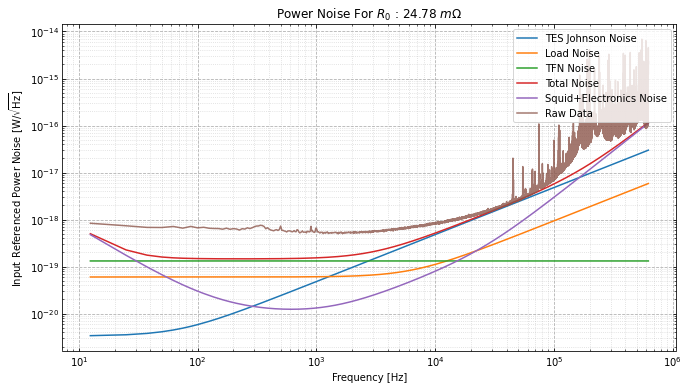

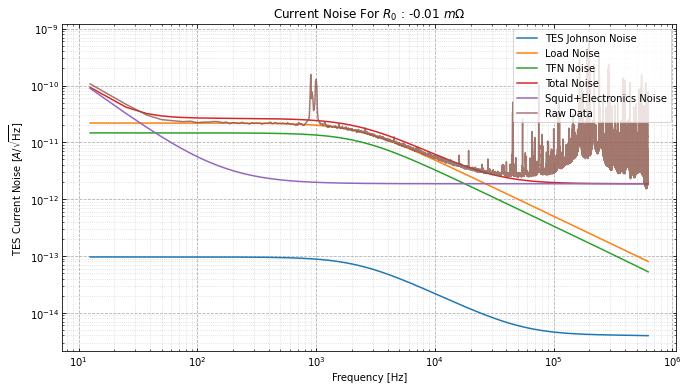

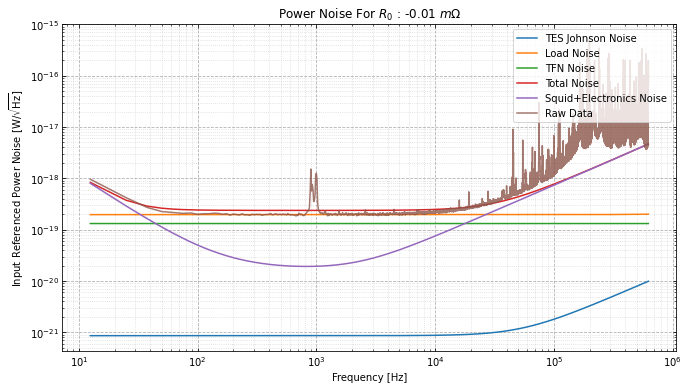

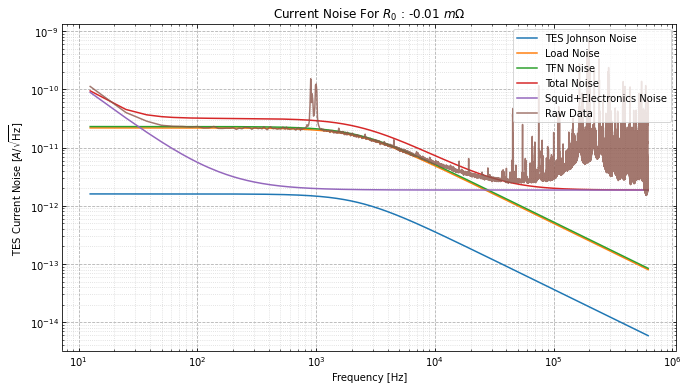

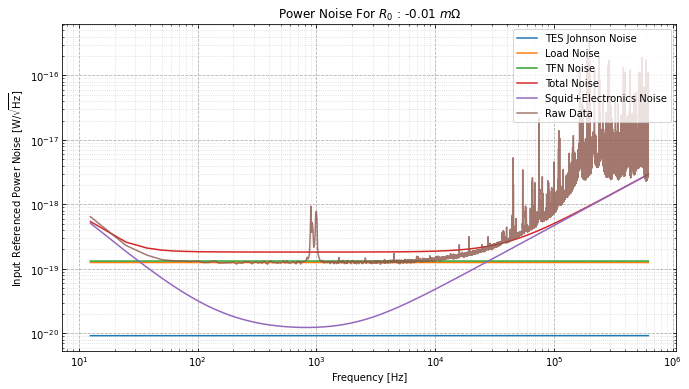

In [20]:
# using  default collection efficiency = 1
IVobj_irptbig.model_noise_simple(lgcplot=True, lgcsave=True,collection_eff=1)

# Offset dictionary (to be populated!)

In [ ]:
'''
sweep_data_path = ['/sdata2/runs/run32/raw/iv_didv_I2_D20230922_T215519/', #1pc
             '/sdata2/runs/run32/raw/iv_didv_I2_D20230923_T094101/', #25pc left
             '/sdata2/runs/run32/raw/iv_didv_I2_D20230923_T131239/'] #25pc right
             ''';

In [166]:
IVobj_all = [IVobj_1pc, IVobj_25pcL, IVobj_25pcR]

In [172]:
rq_files_path = '/home/maggie_reed/processing/run32/didv/RQfiles/darkm3/endsweeps/'

for ichan, chan in enumerate(channels):
    print(f'Starting offset generating of {chan}')
    rawdidvfilepath= sweep_data_path[ichan]
    chans = [str(chan)]
    channel_num=0
    IVobj = IVobj_all[ichan]
    didvfilepath = sorted(glob(rawdidvfilepath))[0]
    traces_temp, metadata = h5read.read_many_events(filepath = didvfilepath,
                                                    nevents=2,
                                                    output_format=2,
                                                    detector_chans=chans,
                                                    include_metadata=True,
                                                    adctoamp = True)
    #generate the offset dictionary
    offset_dict = IVobj.get_offsets_dict(metadata, chans[channel_num])
    print(offset_dict)
    
    save_dict_name = 'offsets_' + str(chan) + "_"
    print("Save as: " + save_dict_name)
    with open(rq_files_path + save_dict_name, 'wb') as handle:
        pickle.dump(offset_dict, handle, protocol=pickle.HIGHEST_PROTOCOL)

Starting offset generating of Melange1pc1ch
{'i0_off': 7.522765034491983e-07, 'i0_off_err': 4.91761570653879e-12, 'ibias_off': -9.041854278240255e-09, 'ibias_off_err': 1.0504787320986771e-11, 'i0_changable_offset': -7.326008e-06, 'rp': 0.0037972771347457067, 'IVobj': <pytesdaq.processing._iv_didv_tools.IVanalysis object at 0x7f8b48161b00>}
Save as: offsets_Melange1pc1ch_
Starting offset generating of Melange025pcLeft
{'i0_off': 6.736871201299345e-08, 'i0_off_err': 7.722176937209634e-12, 'ibias_off': 2.2435721900808138e-08, 'ibias_off_err': 2.1309526776786608e-11, 'i0_changable_offset': -9.67033e-06, 'rp': 0.007590129218415106, 'IVobj': <pytesdaq.processing._iv_didv_tools.IVanalysis object at 0x7f8b48160198>}
Save as: offsets_Melange025pcLeft_
Starting offset generating of Melange025pcRight
{'i0_off': -3.5011117187110863e-09, 'i0_off_err': 4.657423426169963e-12, 'ibias_off': 4.6200174331567883e-08, 'ibias_off_err': 1.0632997345488342e-11, 'i0_changable_offset': -9.86569e-06, 'rp': 0.002